In [1]:
%matplotlib inline

import numpy as np
import copy
import matplotlib.pyplot as plt
import pickle
import random
import torch
from utils import torch_from_numpy
import datetime

from config import cfg_seed, cfg_env, cfg_z_dim, cfg_alpha
seed = cfg_seed


# bif_c = 0.1
num_iter_max=200000
# alpha=0.2
alpha=cfg_alpha
vae_lr=5e-4
ratio_lr=5e-4
ratio_early=100
env_name = 'CustomPendulum-v0'
env_str=cfg_env
figfilenamehead = "fig_policy_optimization_"+env_str+"_iter2_"

loss_list = []
normalized_loss_list = []

print("alpha",alpha)
print(datetime.datetime.now())

alpha 0.1
2023-05-10 13:42:32.495221


In [2]:
import gym
import custom_gym
env = gym.make(env_name)

np.random.seed(seed)
random.seed(seed)
env.seed(seed)
env.action_space.seed(seed)
torch.manual_seed(seed)

s_dim = env.reset().flatten().shape[0]
a_dim = env.action_space.sample().flatten().shape[0]
z_dim = cfg_z_dim
print(s_dim, a_dim, z_dim)



2 1 1


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/proxima-hishinuma/anaconda3/

In [3]:


from sac import SAC
# agent = SAC(env.observation_space.shape[0], env.action_space)
agent = SAC(env.observation_space.shape[0]+z_dim*2, env.action_space)
agent.load_checkpoint(ckpt_path="checkpoints/sac_checkpoint_custom_"+env_str+"_bamdp_weightedvae_")


offline_data = pickle.load(open("offline_data_"+env_str+".pkl","rb"))
debug_info = pickle.load(open("offline_data_debug_info_"+env_str+".pkl","rb"))
debug_info = np.array(debug_info)

Loading models from checkpoints/sac_checkpoint_custom_pendulum_bamdp_weightedvae_


In [4]:
args_init_dict = {
    "offline_data": offline_data,
    "s_dim": s_dim,
    "a_dim": a_dim,
    "z_dim": z_dim,
    #              "policy":agent.select_action,
    "mdp_policy":None,
    "bamdp_policy":agent.policy.my_np_select_action,
    "debug_info":debug_info,
    "env" : env,
    "ckpt_suffix" : env_str
}
# import vi_base
# vi = vi_base.baseVI(args_init_dict)
import vi_iw
iwvi = vi_iw.iwVI(args_init_dict)

iwvi.load(ckpt_key="policy_optimization_iter1")


iwvi load ckpt1, ckpt2 ckpt_iwvi_basepartpendulum_policy_optimization_iter1 ckpt_iwvi_pendulum_policy_optimization_iter1
base load ckpt ckpt_basevi_pendulum_policy_optimization_iter1
base load self.initial_belief.data.sum() tensor(-2.8920)
base load dec.state_dict()['net_phat.0.weight'].sum() tensor(12.4588)
success load ckpt_iwvi_basepartpendulum_policy_optimization_iter1


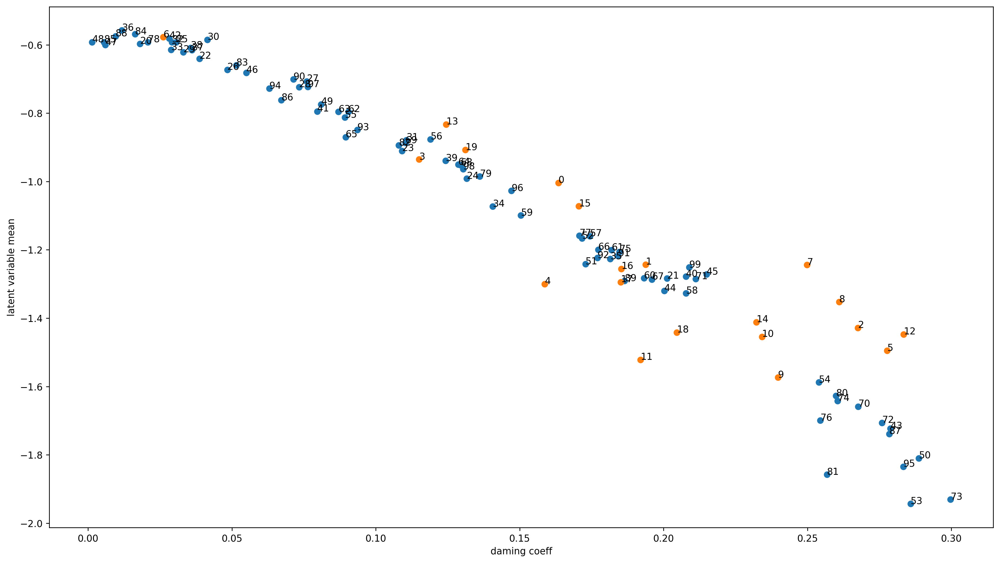

[0.16346495 0.19376823 0.2675319  0.11503246 0.15866848 0.27767899
 0.02613879 0.24978595 0.26100364 0.23974757]
[0.23415875 0.19197631 0.28340068 0.12439858 0.23227011 0.17053018
 0.18529065 0.1850802  0.20454609 0.13110959]
[0.01806764 0.20119136 0.03867789 0.10911323 0.13158045 0.03061344
 0.04839286 0.07598748 0.07332768 0.03311254]
[0.04145489 0.11061755 0.02913038 0.02882952 0.14059536 0.18145366
 0.01175634 0.03605897 0.03561832 0.1242789 ]
[0.20774164 0.07961685 0.02818215 0.27878886 0.20022311 0.21489816
 0.05495741 0.00603226 0.00140864 0.08100239]
[0.28865656 0.1728472  0.17167557 0.2858247  0.2539226  0.08923109
 0.11895172 0.17438186 0.20775948 0.15039731]
[0.19319706 0.18191796 0.09047245 0.08702328 0.12863061 0.0894847
 0.17726183 0.19596025 0.12942553 0.11026856]
[0.26757701 0.21116658 0.27584478 0.2996541  0.26043782 0.18466787
 0.25440247 0.17073022 0.0207501  0.1360628 ]
[0.2599147  0.256741   0.10799342 0.0514889  0.0163014  0.00555654
 0.06717741 0.27842439 0.00955

In [5]:
plt.figure(figsize=(18,10), dpi=250)
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()
plt.xlabel("daming coeff")
plt.ylabel("latent variable mean")

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([-0.05,0.35])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_"+env_str+"_iter0.png")
plt.savefig(figfilenamehead+"damping_latent_"+env_str+"_iter0.eps")
# plt.savefig(figfilenamehead+"damping_latent_"+env_str+"_iter0.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.xlim([0.06,0.14])
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [6]:
iwvi.get_real_rollout_bamdppolicy_data()


 0 1.1920928955078125e-06


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(done, (bool, np.bool8)):
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:141: UserWarning: WARN: The obs returned by the `step()` method was expecting numpy array dtype to be float32, actual type: float64
  logger.warn(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:165: UserWarning: WARN: The obs returned by the `step()` method is not within the observ


 1 6.740990877151489

 2 6.989445924758911

 3 6.972031354904175

 4 6.490553617477417

 5 6.404955863952637

 6 6.591241359710693

 7 6.542227745056152

 8 3.1581928730010986

 9 3.0604114532470703

 10 3.145915985107422

 11 3.1573715209960938

 12 3.141319990158081

 13 3.1114444732666016

 14 3.0090410709381104

 15 3.00089430809021

 16 3.043531894683838

 17 3.1305344104766846

 18 3.1290345191955566

 19 3.091754913330078

 20 3.02590012550354

 21 3.0353686809539795

 22 3.136895179748535

 23 3.0788776874542236

 24 3.074733257293701

 25 3.0344903469085693

 26 3.061849355697632

 27 3.20369291305542

 28 3.2754786014556885

 29 3.1295602321624756

 30 3.179514169692993

 31 3.3317272663116455

 32 3.0437116622924805

 33 3.16353440284729

 34 3.185732126235962

 35 3.2369577884674072

 36 2.998405694961548

 37 3.193889617919922

 38 3.279952049255371

 39 3.11576247215271

 40 3.1129279136657715

 41 3.080369710922241

 42 3.179323196411133

 43 3.1046841144561768

 44 3.2

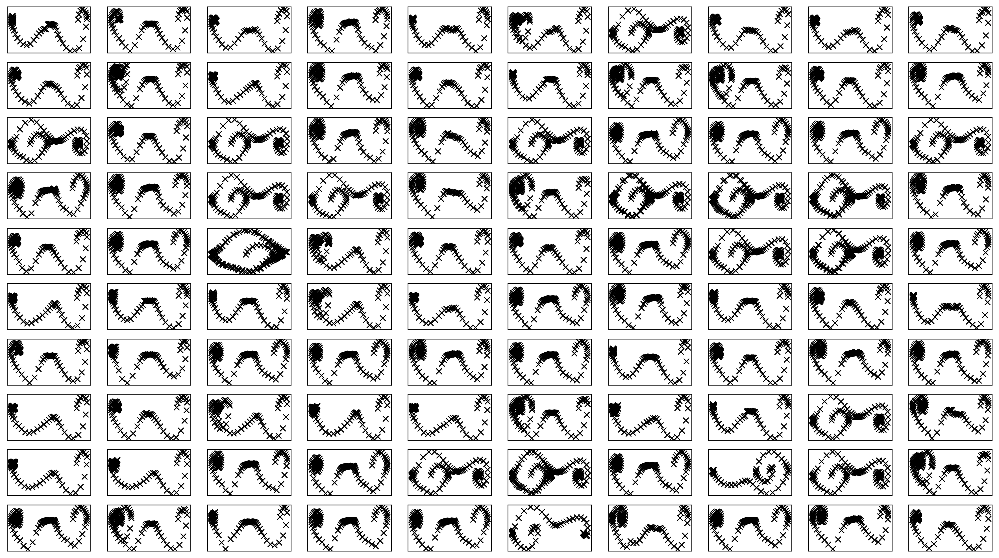

In [7]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.show()

In [8]:
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)


 0 4.76837158203125e-07

 1 3.1437249183654785

 2 3.0690181255340576

 3 3.113250255584717

 4 3.2313573360443115

 5 3.233968496322632

 6 3.1409780979156494

 7 3.2532334327697754

 8 3.142669200897217

 9 3.134794235229492
predict diverge [ 12.75844192 870.5674337 ] sim_timestep 73

 10 1.1349377632141113

 11 3.074655294418335

 12 3.104483127593994

 13 3.1999874114990234

 14 3.0308022499084473

 15 3.059603214263916

 16 3.063490629196167

 17 2.923107862472534

 18 3.3312625885009766

 19 3.1009883880615234

 20 3.079055070877075

 21 3.1850357055664062

 22 3.0584065914154053

 23 3.084238052368164

 24 3.0580883026123047

 25 2.9874203205108643

 26 3.025413751602173

 27 3.036313772201538

 28 3.118894338607788

 29 3.0219976902008057

 30 3.160851240158081

 31 3.0936381816864014

 32 3.022646427154541

 33 3.354863405227661

 34 3.101379632949829

 35 4.045441627502441

 36 6.7251715660095215

 37 6.578022003173828

 38 6.325243949890137

 39 6.424784898757935

 40 6.615

In [9]:
# fig = plt.figure(figsize=(18,10))
# ax_list = []
# for i in range(50):
#     ax_list.append(fig.add_subplot(5, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1]) 
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1]) 
# print("オフラインデータvs実環境方策rollout")

実環境方策rollout vs Sim環境方策rollout


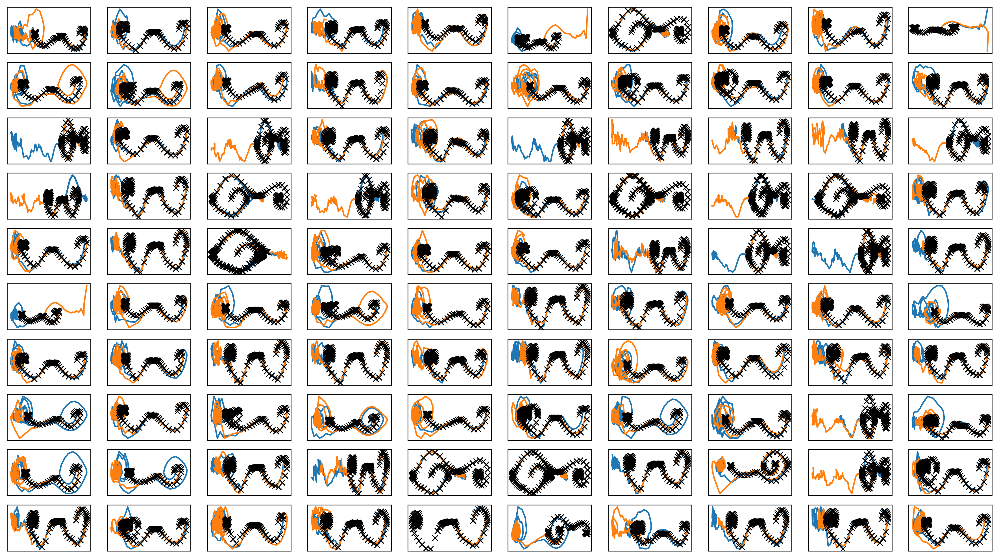

In [10]:

# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"iter0.png")
# plt.savefig(figfilenamehead+"iter0.pdf")
plt.savefig(figfilenamehead+"iter0.eps")
print("実環境方策rollout vs Sim環境方策rollout")

In [11]:
print(datetime.datetime.now())

2023-05-10 14:05:43.978410


# Iter 1

In [12]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1
predict diverge [7.21044164e+00 2.66526819e+04] sim_timestep 26
predict diverge [  14.47923817 6632.77954261] sim_timestep 27
predict diverge [2.21919982e+01 5.41609859e+06] sim_timestep 28
predict diverge [2.99395398e+01 1.74811677e+07] sim_timestep 29
predict diverge [ 3.76574439e+01 -4.04960530e+07] sim_timestep 30
predict diverge [2.82522814e+01 1.89940251e+06] sim_timestep 31
predict diverge [3.60093381e+01 7.75906517e+06] sim_timestep 32
predict diverge [4.36838579e+01 3.27523534e+07] sim_timestep 33
predict diverge [5.16807404e+01 1.82998893e+07] sim_timestep 34
predict diverge [ 5.93578574e+01 -3.90344740e+07] sim_timestep 35
predict diverge [   57.92222977 31949.98839524] sim_timestep 36
predict diverge [ 6.60572743e+01 -1.80466604e+06] sim_timestep 37
predict diverge [    68.06327666 -14100.30804683] sim_timestep 38
predict diverge [   62.20549636 -6398.82033261] sim_timestep 39
predict diverge [   78.49442585 37287.440396  ] sim_timestep 40
predict diverge [ 8.689116

predict diverge [  -87.94021222 -1206.7990436 ] sim_timestep 95
predict diverge [-9.75551233e+01 -3.99292431e+07] sim_timestep 96
predict diverge [-1.08577503e+02 -8.18032390e+06] sim_timestep 97
predict diverge [-1.08699676e+02 -1.11832127e+07] sim_timestep 98
predict diverge [-1.10375645e+02 -4.20961316e+05] sim_timestep 99
predict diverge [-1.07172132e+02 -1.92970798e+07] sim_timestep 100
predict diverge [-1.11805833e+02 -1.75976128e+07] sim_timestep 101
predict diverge [-1.07915788e+02 -3.40468239e+07] sim_timestep 102
predict diverge [-1.04184574e+02  5.46912556e+07] sim_timestep 103
predict diverge [ -90.96511351 -999.46020365] sim_timestep 104
predict diverge [-9.95312501e+01  1.54653385e+07] sim_timestep 105
predict diverge [ -90.58901148 3182.9254536 ] sim_timestep 106
predict diverge [ -81.62642326 -623.46931993] sim_timestep 107
predict diverge [-8.99640798e+01  2.11864354e+07] sim_timestep 108
predict diverge [ -80.9551379  -239.66862355] sim_timestep 109
predict diverge [-

predict diverge [6.79568212e+01 2.37326068e+07] sim_timestep 75
predict diverge [ 7.42212264e+01 -3.16838773e+07] sim_timestep 76
predict diverge [   54.29432841 -6123.80737187] sim_timestep 77
predict diverge [5.62480106e+01 2.23511167e+05] sim_timestep 78
predict diverge [6.44503070e+01 3.52919178e+07] sim_timestep 79
predict diverge [ 7.08235195e+01 -3.53869523e+07] sim_timestep 80
predict diverge [    33.98801906 -12861.90111559] sim_timestep 81
predict diverge [ 2.46655991e+01 -8.53782720e+06] sim_timestep 82
predict diverge [1.64117684e+01 1.79068401e+07] sim_timestep 83
predict diverge [2.41778424e+01 1.64024659e+07] sim_timestep 84
predict diverge [3.19785192e+01 3.07451652e+07] sim_timestep 85
predict diverge [ 3.97215058e+01 -1.73597559e+07] sim_timestep 86
predict diverge [ 3.01483775e+01 -4.34030161e+06] sim_timestep 87
predict diverge [ 2.16980479e+01 -2.03708360e+07] sim_timestep 88
predict diverge [1.33790154e+01 3.72760118e+07] sim_timestep 89
predict diverge [ 2.107036

predict diverge [3.82094201e+01 1.58744643e+06] sim_timestep 35
predict diverge [4.59171768e+01 5.41166365e+06] sim_timestep 36
predict diverge [5.36586437e+01 8.93506994e+05] sim_timestep 37
predict diverge [6.15244153e+01 3.31586631e+06] sim_timestep 38
predict diverge [ 6.91531721e+01 -1.47493340e+06] sim_timestep 39
predict diverge [   51.66258662 -2608.91629447] sim_timestep 40
predict diverge [ 4.06483031e+01 -6.09265727e+04] sim_timestep 41
predict diverge [ 3.04485973e+01 -5.56005977e+04] sim_timestep 42
predict diverge [2.16742440e+01 1.87285611e+06] sim_timestep 43
predict diverge [ 2.92055361e+01 -2.58769159e+05] sim_timestep 44
predict diverge [ 2.01055953e+01 -2.41237235e+06] sim_timestep 45
predict diverge [1.13607765e+01 4.51120018e+05] sim_timestep 46
predict diverge [1.88145023e+01 2.17988963e+04] sim_timestep 47
predict diverge [    26.32060241 -19086.56120978] sim_timestep 48
predict diverge [1.73306210e+01 4.86070524e+05] sim_timestep 49
predict diverge [2.48654022e

predict diverge [-7.44148400e+01  1.01929487e+08] sim_timestep 141
predict diverge [-60.24367263 104.18660626] sim_timestep 143
predict diverge [-51.58732259 121.47540292] sim_timestep 144
predict diverge [-42.90952939 758.99496073] sim_timestep 145
predict diverge [ -34.26463774 2863.35012596] sim_timestep 146
predict diverge [  -25.69454679 12065.99586079] sim_timestep 147
predict diverge [-1.71667556e+01  1.91313252e+04] sim_timestep 148

 40

 41

 42

 43

 44

 45

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57
predict diverge [   12.75249863 -1010.96048711] sim_timestep 33
predict diverge [ 4.24987246e+00 -3.37961542e+06] sim_timestep 34
predict diverge [-4.26423919e+00  1.98489495e+05] sim_timestep 35
predict diverge [   4.06874751 1291.51942494] sim_timestep 36
predict diverge [  7.22639188 773.89300175] sim_timestep 40
predict diverge [  14.47821651 9727.59147094] sim_timestep 41
predict diverge [ 2.22840566e+01 -1.92310286e+06] sim_timestep 42
predict diverge [1.

predict diverge [  26.81265929 -316.3287562 ] sim_timestep 61
predict diverge [1.82793810e+01 1.28853112e+06] sim_timestep 62
predict diverge [2.59038079e+01 6.33771847e+04] sim_timestep 63
predict diverge [ 3.34418353e+01 -8.69105095e+05] sim_timestep 64
predict diverge [ 2.46849334e+01 -3.80968208e+05] sim_timestep 65
predict diverge [1.5775837e+01 8.2703966e+06] sim_timestep 66
predict diverge [ 2.33517892e+01 -6.93635801e+05] sim_timestep 67
predict diverge [1.44111421e+01 9.11591153e+06] sim_timestep 68
predict diverge [2.20194449e+01 2.53870546e+06] sim_timestep 69
predict diverge [2.95717981e+01 4.32124060e+05] sim_timestep 70
predict diverge [ 3.71708385e+01 -2.40718859e+06] sim_timestep 71
predict diverge [ 2.80760603e+01 -1.34399253e+05] sim_timestep 72
predict diverge [1.91715144e+01 9.17785088e+06] sim_timestep 73

 80

 81

 82

 83

 84

 85

 86

 87

 88

 89

 90

 91

 92
predict diverge [  12.36801676 -137.89215009] sim_timestep 24
predict diverge [3.96716484e+00 1.3

In [13]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
# iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 2.23591  validloss 5.19733±0.00000  bestvalidloss 5.19733  last_update 0
train: iter 1  trainloss 0.82545  validloss 0.92623±0.00000  bestvalidloss 0.92623  last_update 0
train: iter 2  trainloss 0.66147  validloss 0.60621±0.00000  bestvalidloss 0.60621  last_update 0
train: iter 3  trainloss 0.60402  validloss 0.53855±0.00000  bestvalidloss 0.53855  last_update 0
train: iter 4  trainloss 0.57469  validloss 0.49029±0.00000  bestvalidloss 0.49029  last_update 0
train: iter 5  trainloss 0.54964  validloss 0.46389±0.00000  bestvalidloss 0.46389  last_update 0
train: iter 6  trainloss 0.53022  validloss 0.44616±0.00000  bestvalidloss 0.44616  last_update 0
train: iter 7  trainloss 0.51065  validloss 0.43018±0.00000  bestvalidloss 0.43018  last_update 0
train: iter 8  trainloss 0.49267  validloss 0.40665±0.00000  bestvalidloss 0.40665  last_update 0
train: iter 9  trainloss 0.47654  validloss 0.39098±0.00000  bestvalidloss 0.39098  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.29124  validloss 0.25853±0.00000  bestvalidloss 0.25853  last_update 0
train: iter 84  trainloss 0.29104  validloss 0.26307±0.00000  bestvalidloss 0.25853  last_update 1
train: iter 85  trainloss 0.28899  validloss 0.26352±0.00000  bestvalidloss 0.25853  last_update 2
train: iter 86  trainloss 0.28921  validloss 0.26423±0.00000  bestvalidloss 0.25853  last_update 3
train: iter 87  trainloss 0.29017  validloss 0.26310±0.00000  bestvalidloss 0.25853  last_update 4
train: iter 88  trainloss 0.28941  validloss 0.26321±0.00000  bestvalidloss 0.25853  last_update 5
train: iter 89  trainloss 0.28815  validloss 0.26577±0.00000  bestvalidloss 0.25853  last_update 6
train: iter 90  trainloss 0.28528  validloss 0.25877±0.00000  bestvalidloss 0.25853  last_update 7
train: iter 91  trainloss 0.28698  validloss 0.25568±0.00000  bestvalidloss 0.25568  last_update 0
train: iter 92  trainloss 0.28647  validloss 0.25926±0.00000  bestvalidloss 0.25568  last_update 1
train: ite

train: iter 165  trainloss 0.25589  validloss 0.25966±0.00000  bestvalidloss 0.24908  last_update 15
train: iter 166  trainloss 0.25566  validloss 0.25369±0.00000  bestvalidloss 0.24908  last_update 16
train: iter 167  trainloss 0.25544  validloss 0.25005±0.00000  bestvalidloss 0.24908  last_update 17
train: iter 168  trainloss 0.25663  validloss 0.25365±0.00000  bestvalidloss 0.24908  last_update 18
train: iter 169  trainloss 0.25436  validloss 0.26728±0.00000  bestvalidloss 0.24908  last_update 19
train: iter 170  trainloss 0.25358  validloss 0.25162±0.00000  bestvalidloss 0.24908  last_update 20
train: iter 171  trainloss 0.25425  validloss 0.25620±0.00000  bestvalidloss 0.24908  last_update 21
train: iter 172  trainloss 0.25243  validloss 0.25583±0.00000  bestvalidloss 0.24908  last_update 22
train: iter 173  trainloss 0.25324  validloss 0.24870±0.00000  bestvalidloss 0.24870  last_update 0
train: iter 174  trainloss 0.25605  validloss 0.25807±0.00000  bestvalidloss 0.24870  last_u

train: iter 247  trainloss 0.24345  validloss 0.25733±0.00000  bestvalidloss 0.24870  last_update 74
train: iter 248  trainloss 0.24243  validloss 0.26232±0.00000  bestvalidloss 0.24870  last_update 75
train: iter 249  trainloss 0.24431  validloss 0.25194±0.00000  bestvalidloss 0.24870  last_update 76
train: iter 250  trainloss 0.24172  validloss 0.25553±0.00000  bestvalidloss 0.24870  last_update 77
train: iter 251  trainloss 0.24308  validloss 0.25142±0.00000  bestvalidloss 0.24870  last_update 78
train: iter 252  trainloss 0.24277  validloss 0.25969±0.00000  bestvalidloss 0.24870  last_update 79
train: iter 253  trainloss 0.24125  validloss 0.25431±0.00000  bestvalidloss 0.24870  last_update 80
train: iter 254  trainloss 0.24284  validloss 0.25479±0.00000  bestvalidloss 0.24870  last_update 81
train: iter 255  trainloss 0.24067  validloss 0.25276±0.00000  bestvalidloss 0.24870  last_update 82
train: iter 256  trainloss 0.24207  validloss 0.26078±0.00000  bestvalidloss 0.24870  last_

([2.235913824290037,
  0.8254465024918318,
  0.6614656813442708,
  0.6040240587666631,
  0.574686917103827,
  0.5496390318498016,
  0.5302241740748286,
  0.5106470381841064,
  0.492670938372612,
  0.4765445735305548,
  0.4608594374731183,
  0.44990675114095213,
  0.43854074385017155,
  0.430027030967176,
  0.4227812519297004,
  0.41439819540828465,
  0.40799865685403347,
  0.4025305399671197,
  0.39752620179206133,
  0.39405093882232906,
  0.38985455092042687,
  0.3842260681092739,
  0.3800545375794172,
  0.3743419600650668,
  0.37511342763900757,
  0.3676919950172305,
  0.3672239089384675,
  0.3634547606110573,
  0.3591570297256112,
  0.3587574907578528,
  0.357685767672956,
  0.3542368421331048,
  0.3527894612401724,
  0.3503556350246072,
  0.3499925032258034,
  0.34818558413535355,
  0.3459146238863468,
  0.34393603103235365,
  0.34400309408083557,
  0.3418150024488568,
  0.33978391662240026,
  0.34053836204111576,
  0.339429568964988,
  0.3348915665410459,
  0.3362457356415689,
  0

In [14]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -301.70619535684585
valid_loss:  -128.89740283727647
train_loss:  -546.4487967115641
valid_loss:  -470.3487115478516


1e-08 1000.0


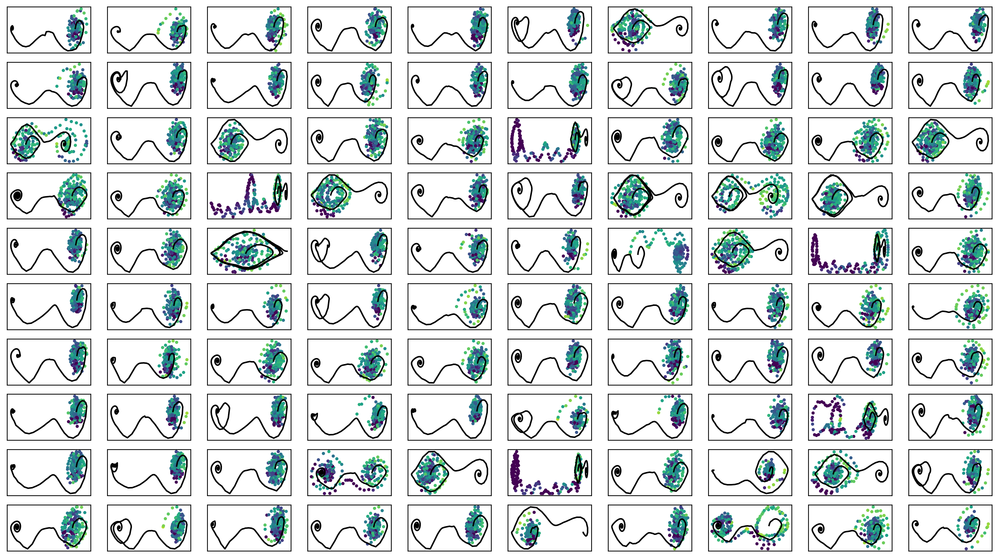

In [15]:

def f(x):
#     return x
    return np.log10(x)

fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter1.png")

In [16]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [17]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [18]:
# for i in range(100):
#     print(i, " ", end="")
#     fig = plt.figure(figsize=(16,10), dpi=150)
#     fig.patch.set_facecolor('white')
#     plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#                vmin=-8, vmax=3
#                )
#     plt.colorbar()
#     plt.savefig("ratio"+str(i)+".png")
#     plt.close()

In [19]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()

train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -538.64751  validloss -470.25855±0.00000  bestvalidloss -470.25855  last_update 0
train: iter 1  trainloss -557.75900  validloss -477.50933±0.00000  bestvalidloss -477.50933  last_update 0
train: iter 2  trainloss -555.39772  validloss -506.33074±0.00000  bestvalidloss -506.33074  last_update 0
train: iter 3  trainloss -534.90653  validloss -507.61276±0.00000  bestvalidloss -507.61276  last_update 0
train: iter 4  trainloss -541.16531  validloss -477.79836±0.00000  bestvalidloss -507.61276  last_update 1
train: iter 5  trainloss -560.64678  validloss -499.17959±0.00000  bestvalidloss -507.61276  last_update 2
train: iter 6  trainloss -536.96775  validloss -507.93222±0.00000  bestvalidloss -507.93222  last_update 0
train: iter 7  trainloss -557.13973  validloss -512.34252±0.00000  bestvalidloss -512.34252  last_update 0
train: iter 8  trainloss -548.41179  validloss -496.85915±0.00000  bestvalidloss -512.34252  last_u

train: iter 76  trainloss -563.97446  validloss -504.49588±0.00000  bestvalidloss -516.52070  last_update 42
train: iter 77  trainloss -563.10943  validloss -508.73111±0.00000  bestvalidloss -516.52070  last_update 43
train: iter 78  trainloss -551.20761  validloss -489.07354±0.00000  bestvalidloss -516.52070  last_update 44
train: iter 79  trainloss -552.59830  validloss -451.84036±0.00000  bestvalidloss -516.52070  last_update 45
train: iter 80  trainloss -558.50117  validloss -461.17849±0.00000  bestvalidloss -516.52070  last_update 46
train: iter 81  trainloss -539.08781  validloss -458.35322±0.00000  bestvalidloss -516.52070  last_update 47
train: iter 82  trainloss -528.39746  validloss -509.39292±0.00000  bestvalidloss -516.52070  last_update 48
train: iter 83  trainloss -555.39439  validloss -522.34185±0.00000  bestvalidloss -522.34185  last_update 0
train: iter 84  trainloss -561.01398  validloss -486.38752±0.00000  bestvalidloss -522.34185  last_update 1
train: iter 85  train

train: iter 151  trainloss -554.07824  validloss -477.27271±0.00000  bestvalidloss -522.34185  last_update 68
train: iter 152  trainloss -558.19976  validloss -489.99777±0.00000  bestvalidloss -522.34185  last_update 69
train: iter 153  trainloss -569.87463  validloss -505.71595±0.00000  bestvalidloss -522.34185  last_update 70
train: iter 154  trainloss -570.32288  validloss -476.59847±0.00000  bestvalidloss -522.34185  last_update 71
train: iter 155  trainloss -570.18659  validloss -497.27678±0.00000  bestvalidloss -522.34185  last_update 72
train: iter 156  trainloss -547.77110  validloss -478.78219±0.00000  bestvalidloss -522.34185  last_update 73
train: iter 157  trainloss -563.64894  validloss -505.12874±0.00000  bestvalidloss -522.34185  last_update 74
train: iter 158  trainloss -561.55494  validloss -503.02954±0.00000  bestvalidloss -522.34185  last_update 75
train: iter 159  trainloss -566.01492  validloss -505.90667±0.00000  bestvalidloss -522.34185  last_update 76
train: ite

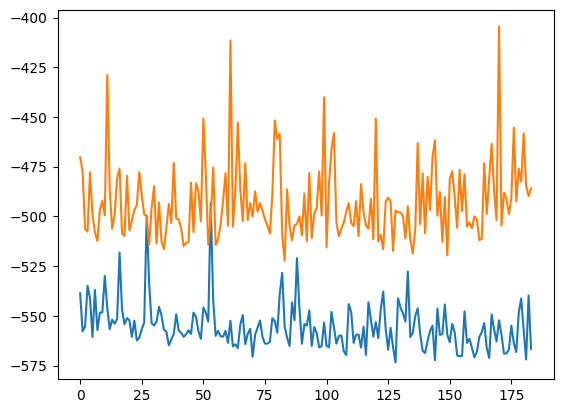

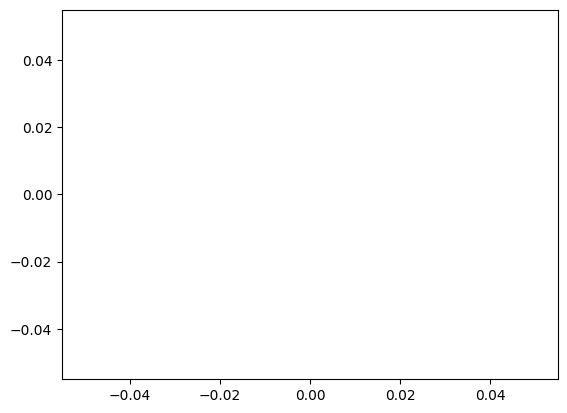

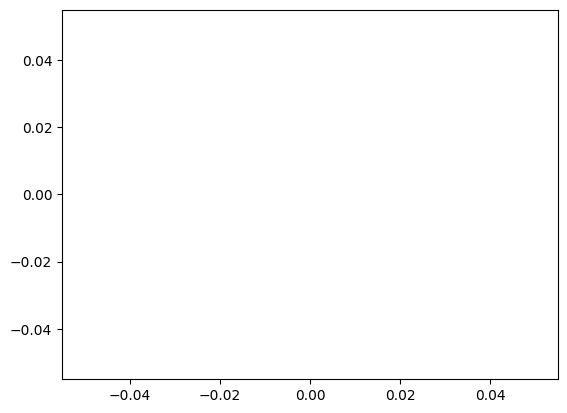

alpha 0.1 vae_lr 0.0005


In [20]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

plt.plot(train_curve2)
plt.plot(valid_curve2)
plt.show()

plt.plot(train_curve3)
plt.plot(valid_curve3)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)

In [21]:
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)




 0 7.152557373046875e-07

 1 3.111025810241699

 2 3.1459312438964844

 3 3.8047428131103516

 4 3.027592420578003

 5 3.106873035430908

 6 3.150441884994507

 7 3.1982858180999756

 8 3.1829562187194824

 9 3.2506608963012695

 10 3.458462953567505

 11 3.2591958045959473

 12 3.0389087200164795

 13 3.0612423419952393

 14 3.1125009059906006

 15 3.2275350093841553

 16 3.097667694091797

 17 4.751422643661499

 18 6.612250566482544

 19 6.516185522079468

 20 6.459968566894531

 21 6.234136581420898

 22 3.063732385635376

 23 3.7780144214630127

 24 3.1426026821136475

 25 3.929664134979248

 26 5.302668571472168

 27 6.452713489532471

 28 6.153301239013672

 29 3.3920199871063232

 30 3.0001027584075928

 31 3.705580949783325

 32 3.547611713409424

 33 4.607627630233765

 34 5.193934440612793

 35 3.125908374786377

 36 3.0895228385925293

 37 3.049867868423462

 38 3.1899001598358154

 39 3.0026462078094482

 40 3.083853006362915

 41 3.422255516052246

 42 3.2111852169036865

実環境方策rollout vs Sim環境方策rollout


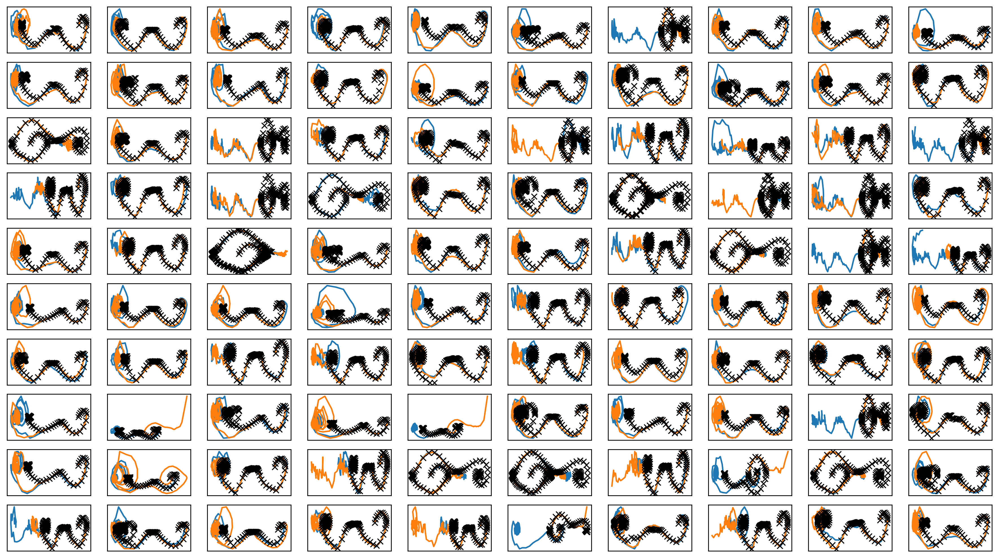

In [22]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"iter1.png")
plt.savefig(figfilenamehead+"iter1.eps")
# plt.savefig(figfilenamehead+"iter1.pdf")
print("実環境方策rollout vs Sim環境方策rollout")

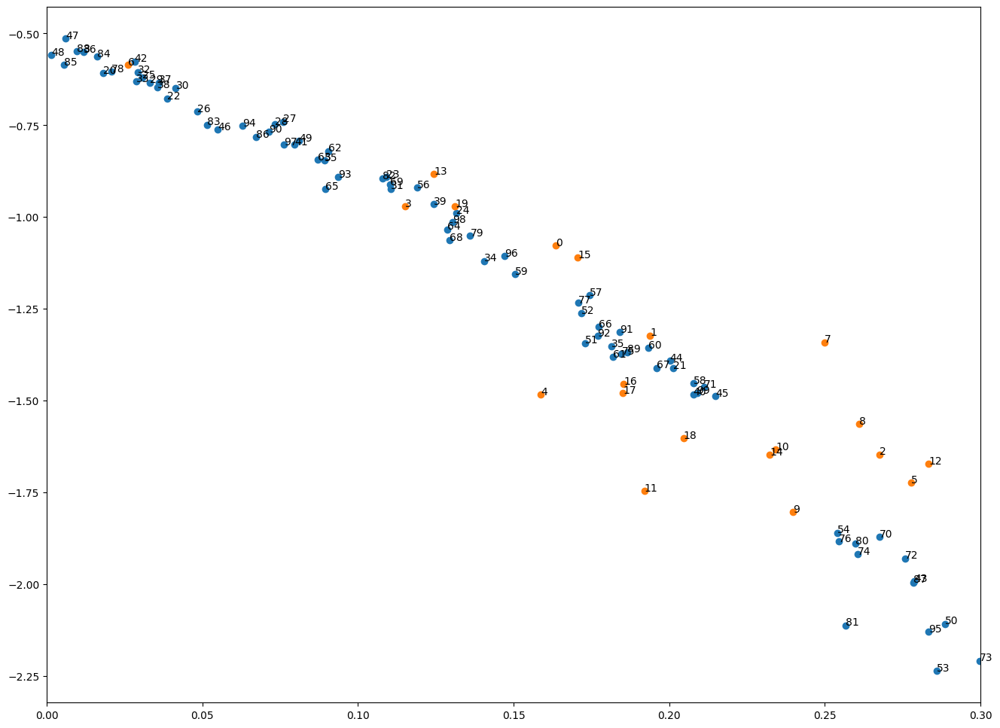

[0.16346495 0.19376823 0.2675319  0.11503246 0.15866848 0.27767899
 0.02613879 0.24978595 0.26100364 0.23974757]
[0.23415875 0.19197631 0.28340068 0.12439858 0.23227011 0.17053018
 0.18529065 0.1850802  0.20454609 0.13110959]
[0.01806764 0.20119136 0.03867789 0.10911323 0.13158045 0.03061344
 0.04839286 0.07598748 0.07332768 0.03311254]
[0.04145489 0.11061755 0.02913038 0.02882952 0.14059536 0.18145366
 0.01175634 0.03605897 0.03561832 0.1242789 ]
[0.20774164 0.07961685 0.02818215 0.27878886 0.20022311 0.21489816
 0.05495741 0.00603226 0.00140864 0.08100239]
[0.28865656 0.1728472  0.17167557 0.2858247  0.2539226  0.08923109
 0.11895172 0.17438186 0.20775948 0.15039731]
[0.19319706 0.18191796 0.09047245 0.08702328 0.12863061 0.0894847
 0.17726183 0.19596025 0.12942553 0.11026856]
[0.26757701 0.21116658 0.27584478 0.2996541  0.26043782 0.18466787
 0.25440247 0.17073022 0.0207501  0.1360628 ]
[0.2599147  0.256741   0.10799342 0.0514889  0.0163014  0.00555654
 0.06717741 0.27842439 0.00955

In [23]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter1.png")
plt.savefig(figfilenamehead+"damping_latent_iter1.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter1.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [24]:
print(datetime.datetime.now())

2023-05-10 14:45:11.212086


# Iter2

In [25]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0

 1
predict diverge [ 12.39094226 484.98805888] sim_timestep 40
predict diverge [1.96393659e+01 3.72352870e+05] sim_timestep 41
predict diverge [ 2.68646454e+01 -1.72853935e+06] sim_timestep 42
predict diverge [-6.34986961e+01  5.51564517e+06] sim_timestep 43
predict diverge [  -54.79092899 -6793.48533538] sim_timestep 44
predict diverge [-6.34299126e+01 -3.53875164e+05] sim_timestep 45
predict diverge [-7.19098280e+01 -1.00583879e+06] sim_timestep 46
predict diverge [-7.99308537e+01 -2.75027006e+05] sim_timestep 47
predict diverge [-8.77226478e+01 -5.35090223e+05] sim_timestep 48
predict diverge [-9.59996016e+01 -1.76450771e+05] sim_timestep 49
predict diverge [-1.04025159e+02 -1.56621784e+05] sim_timestep 50
predict diverge [ -108.18612286 -3208.80580578] sim_timestep 51
predict diverge [-1.08435827e+02  1.54950130e+05] sim_timestep 52
predict diverge [   -91.03087058 -25827.09049413] sim_timestep 53
predict diverge [  -98.9243734  62477.50609156] sim_timestep 54
predict diverge 

predict diverge [  -53.24885752 31797.75484824] sim_timestep 95
predict diverge [   -44.56385215 -17649.96380229] sim_timestep 96
predict diverge [-5.33641477e+01  1.15730820e+06] sim_timestep 97
predict diverge [  -44.69146268 -4292.05558679] sim_timestep 98
predict diverge [-5.36434323e+01 -3.28258786e+05] sim_timestep 99
predict diverge [-6.26905444e+01 -1.64474987e+05] sim_timestep 100
predict diverge [-7.11299038e+01  9.47421244e+05] sim_timestep 101
predict diverge [  -62.38673946 -1250.51199903] sim_timestep 102
predict diverge [-7.07897177e+01  3.48177148e+05] sim_timestep 103
predict diverge [ -62.06464251 1805.39836018] sim_timestep 104
predict diverge [   -53.37493302 -11434.20281971] sim_timestep 105
predict diverge [-6.20268394e+01  5.78318539e+05] sim_timestep 106
predict diverge [  -53.30010975 10604.39691976] sim_timestep 107
predict diverge [   -44.61478416 -18483.6079891 ] sim_timestep 108
predict diverge [   -53.71038062 -39841.761894  ] sim_timestep 109
predict dive

predict diverge [2.56633346e+01 2.41748575e+07] sim_timestep 69
predict diverge [ 3.30726509e+01 -7.69912986e+05] sim_timestep 70
predict diverge [-2.53762858e+01  6.35434671e+08] sim_timestep 71
predict diverge [-1.67980464e+01 -2.39463328e+05] sim_timestep 72
predict diverge [-2.61975583e+01 -6.63060013e+04] sim_timestep 73
predict diverge [   -35.49111336 -14918.94257513] sim_timestep 74
predict diverge [-4.45154662e+01  4.34800316e+05] sim_timestep 75
predict diverge [   -35.88082473 -34957.83529944] sim_timestep 76
predict diverge [-4.49710575e+01  1.39505392e+05] sim_timestep 77
predict diverge [ -36.28311669 3142.63271315] sim_timestep 78
predict diverge [-2.76396671e+01  2.13760818e+05] sim_timestep 79
predict diverge [-1.90252382e+01 -3.14445766e+05] sim_timestep 80
predict diverge [   -28.41593355 -18309.15667213] sim_timestep 81
predict diverge [-3.75772580e+01  1.97230372e+05] sim_timestep 82
predict diverge [-2.89452707e+01 -5.67891861e+04] sim_timestep 83
predict diverge 

predict diverge [ -14.51764007 1084.85644692] sim_timestep 62
predict diverge [  13.00442908 1635.32621988] sim_timestep 53
predict diverge [2.06958017e+01 1.28626469e+08] sim_timestep 54
predict diverge [ 2.82209141e+01 -1.51449196e+07] sim_timestep 55
predict diverge [1.48768803e+02 1.94316533e+08] sim_timestep 56
predict diverge [ 1.03094703e+02 -7.40165429e+05] sim_timestep 57
predict diverge [   48679.90695898 -1447551.4333314 ] sim_timestep 58
predict diverge [  89930.12394553 1137385.91783257] sim_timestep 59
predict diverge [ 1.08266403e+02 -5.00022336e+05] sim_timestep 60
predict diverge [ 53913.7276215  785904.86923677] sim_timestep 61
predict diverge [ 9.68417592e+01 -8.02156050e+05] sim_timestep 62
predict diverge [    981.76411208 -854720.8451798 ] sim_timestep 63
predict diverge [    6434.56283178 -1138402.49410136] sim_timestep 64
predict diverge [ -53640.19941592 -509342.15767107] sim_timestep 65
predict diverge [ -107.65806835 27394.7979861 ] sim_timestep 66
predict di

predict diverge [ 1.03457370e+02 -1.15749431e+06] sim_timestep 59
predict diverge [  33042.81175373 -455898.2823081 ] sim_timestep 60
predict diverge [  44263.02497082 2243363.38603978] sim_timestep 61
predict diverge [1.19263071e+02 1.14733418e+06] sim_timestep 62
predict diverge [ 9.68516990e+01 -6.54185637e+05] sim_timestep 63
predict diverge [  99884.2880989  -824553.03876591] sim_timestep 64
predict diverge [-106783.01628795  176939.96211602] sim_timestep 65

 10
predict diverge [ 1.67715634e+01 -1.63154156e+05] sim_timestep 67
predict diverge [ 13.83046095 319.60184863] sim_timestep 62
predict diverge [2.12812052e+01 1.51055227e+07] sim_timestep 63
predict diverge [ 2.86839359e+01 -1.16445026e+07] sim_timestep 64
predict diverge [-1.67867504e+02 -9.04817747e+07] sim_timestep 65
predict diverge [ -108.32881265 26959.5410315 ] sim_timestep 66
predict diverge [   -90.96294631 -34389.87422918] sim_timestep 67
predict diverge [  -99.1080488  70853.83521448] sim_timestep 68
predict div

predict diverge [ -54.23299151 3047.94067048] sim_timestep 97
predict diverge [  -45.52157484 29497.13531634] sim_timestep 98
predict diverge [   -36.51652968 -14749.6930988 ] sim_timestep 99
predict diverge [-4.56842403e+01  7.37042653e+04] sim_timestep 100
predict diverge [-3.70066843e+01  3.86217353e+04] sim_timestep 101
predict diverge [  -28.39440556 13475.59360079] sim_timestep 102
predict diverge [-1.98083944e+01  2.06558824e+05] sim_timestep 103
predict diverge [-1.11724442e+01  1.26664264e+04] sim_timestep 104
predict diverge [-2.85573518e+00  4.87266630e+04] sim_timestep 105
predict diverge [5.33803891e+00 3.16039175e+04] sim_timestep 106
predict diverge [8.34498607e+00 4.35791201e+04] sim_timestep 51
predict diverge [1.55720621e+01 5.55741195e+05] sim_timestep 52
predict diverge [ 2.30130372e+01 -3.72078188e+07] sim_timestep 53
predict diverge [ 5.96088188e+01 -2.29307611e+08] sim_timestep 54
predict diverge [-1.01463623e+03 -4.46884955e+06] sim_timestep 55
predict diverge [

predict diverge [   13.16090936 -4334.01018008] sim_timestep 74
predict diverge [ 4.61991751e+00 -1.16808593e+07] sim_timestep 75
predict diverge [-3.85511937e+00  4.09143897e+03] sim_timestep 76
predict diverge [ 4.34332266e+00 -1.23862683e+05] sim_timestep 77
predict diverge [-4.12251672e+00 -1.18887575e+04] sim_timestep 78
predict diverge [ -8.31294398 141.04411185] sim_timestep 80
predict diverge [-6.25133333e-02  1.28187397e+05] sim_timestep 81
predict diverge [8.05644900e+00 1.09481479e+04] sim_timestep 82
predict diverge [ 1.52690177e+01 -4.43392629e+05] sim_timestep 83
predict diverge [ 5.57713441e+00 -4.18119069e+08] sim_timestep 84
predict diverge [-2.86052020e+00 -7.51947636e+03] sim_timestep 85
predict diverge [-11.5575875  771.92456399] sim_timestep 86
predict diverge [-3.19285275e+00 -1.61874955e+05] sim_timestep 87
predict diverge [  -11.89659725 -1806.26922796] sim_timestep 88
predict diverge [-2.11680766e+01 -3.07630769e+04] sim_timestep 89
predict diverge [   -30.4870

predict diverge [  12.14771367 -422.22005561] sim_timestep 33
predict diverge [ 5.99705143e+00 -6.44197738e+07] sim_timestep 34
predict diverge [-2.47330820e+00 -5.53922536e+04] sim_timestep 35
predict diverge [-11.19416239 390.90200983] sim_timestep 36
predict diverge [-2.83648336e+00 -1.27807584e+05] sim_timestep 37

 17

 18
predict diverge [  5.10882663 155.73968616] sim_timestep 76
predict diverge [  12.40238398 9339.40301385] sim_timestep 77
predict diverge [ 1.98344310e+01 -1.82850619e+05] sim_timestep 78
predict diverge [ 1.52175729e+01 -2.86058160e+08] sim_timestep 79
predict diverge [ 8.05393885e+00 -3.57559818e+07] sim_timestep 80
predict diverge [-2.66705545e-01 -2.36293529e+05] sim_timestep 81
predict diverge [  -8.70149546 1531.21686257] sim_timestep 82
predict diverge [-4.20701702e-01 -1.10084300e+05] sim_timestep 83
predict diverge [   -8.83157595 -1884.97484981] sim_timestep 84
predict diverge [  -17.90758971 -7241.96498771] sim_timestep 85
predict diverge [   -27.3338

predict diverge [ -18.10283035 -891.78512416] sim_timestep 43
predict diverge [ -27.67464715 9887.64657996] sim_timestep 44
predict diverge [ -19.16337633 8571.9340663 ] sim_timestep 45
predict diverge [-1.05490616e+01 -6.30072258e+04] sim_timestep 46
predict diverge [  -19.88420128 11886.78628989] sim_timestep 47
predict diverge [-1.13200480e+01 -1.03800766e+05] sim_timestep 48
predict diverge [  -20.78177048 -9243.60520978] sim_timestep 49
predict diverge [ -30.24442348 -789.37955013] sim_timestep 50
predict diverge [-3.95479107e+01 -1.03568351e+05] sim_timestep 51
predict diverge [-4.87140502e+01 -2.15284184e+05] sim_timestep 52
predict diverge [-5.72495881e+01 -4.54056057e+05] sim_timestep 53
predict diverge [-6.63599761e+01  1.34036702e+05] sim_timestep 54
predict diverge [-57.47742765 515.42893014] sim_timestep 55
predict diverge [ -48.82831472 3818.76071187] sim_timestep 56
predict diverge [-4.01624507e+01 -4.71768223e+04] sim_timestep 57
predict diverge [  -49.21025715 -9444.04


 42

 43

 44

 45
predict diverge [   8.52882853 -244.97425804] sim_timestep 44
predict diverge [ 1.49345893e-01 -4.91192208e+05] sim_timestep 45
predict diverge [ -8.22524131 218.54665081] sim_timestep 46
predict diverge [8.15111110e-02 2.18618759e+05] sim_timestep 47
predict diverge [8.26085785e+00 8.45199109e+03] sim_timestep 48
predict diverge [1.54083577e+01 3.47144361e+05] sim_timestep 49
predict diverge [2.27962254e+01 5.04563104e+06] sim_timestep 50
predict diverge [3.01555109e+01 6.40536908e+06] sim_timestep 51
predict diverge [ 3.74757753e+01 -1.19516472e+07] sim_timestep 52
predict diverge [-1.41011535e+02 -5.37447259e+07] sim_timestep 53
predict diverge [-1.07789324e+02  1.25225668e+05] sim_timestep 54
predict diverge [ -91.00363093 9545.51850619] sim_timestep 55

 46

 47

 48

 49

 50

 51

 52

 53

 54

 55

 56

 57

 58

 59
predict diverge [ 14.80659189 520.70659195] sim_timestep 48
predict diverge [2.1930824e+01 3.6141137e+05] sim_timestep 49
predict diverge [ 2.

predict diverge [-5.78449828e-02 -5.23963414e+04] sim_timestep 112
predict diverge [2.11430275e+00 3.96884368e+03] sim_timestep 115
predict diverge [  14.27681153 1292.97146097] sim_timestep 120
predict diverge [2.14356820e+01 3.76129729e+05] sim_timestep 121
predict diverge [ 2.85217304e+01 -5.44054829e+05] sim_timestep 122
predict diverge [-6.13764160e+01  1.50753761e+07] sim_timestep 123
predict diverge [ -52.68690323 3851.17393001] sim_timestep 124
predict diverge [  -44.04570263 15546.16750194] sim_timestep 125
predict diverge [   -35.44307475 -12838.73029269] sim_timestep 126
predict diverge [-4.48667997e+01  2.88593276e+05] sim_timestep 127
predict diverge [   -36.26407132 -35528.31990803] sim_timestep 128
predict diverge [-4.54919052e+01  5.34176997e+05] sim_timestep 129
predict diverge [  -36.85154164 11593.61270006] sim_timestep 130
predict diverge [-2.82724952e+01 -2.93375448e+04] sim_timestep 131
predict diverge [-3.75920661e+01 -6.61520207e+04] sim_timestep 132
predict div

predict diverge [  -34.05683413 -5793.97023985] sim_timestep 119
predict diverge [-4.33628103e+01  2.38802380e+05] sim_timestep 120
predict diverge [-3.47059936e+01 -4.41834870e+04] sim_timestep 121
predict diverge [-4.39457292e+01 -8.21035885e+04] sim_timestep 122
predict diverge [-5.27535234e+01 -3.40483342e+05] sim_timestep 123
predict diverge [-6.14418611e+01 -1.95057776e+05] sim_timestep 124

 62

 63

 64
predict diverge [ 9.44564343e+00 -3.16691480e+05] sim_timestep 34
predict diverge [9.35825058e-01 7.23362755e+04] sim_timestep 35
predict diverge [   9.16791071 6336.07533136] sim_timestep 36
predict diverge [ 1.62513091e+01 -1.03619190e+05] sim_timestep 37
predict diverge [ 1.05175548e+01 -5.04550561e+06] sim_timestep 38
predict diverge [ 2.38625224e+00 -5.05424843e+06] sim_timestep 39
predict diverge [ -6.01088151 460.45140811] sim_timestep 40
predict diverge [ 2.23305595e+00 -6.29348023e+04] sim_timestep 41
predict diverge [  -6.15226062 -182.29735658] sim_timestep 42
predict

predict diverge [   -53.68773016 -20248.39364936] sim_timestep 77
predict diverge [-6.21537639e+01 -3.31457853e+05] sim_timestep 78
predict diverge [-7.06503261e+01 -4.68012848e+05] sim_timestep 79
predict diverge [-7.88587776e+01  2.18512637e+06] sim_timestep 80
predict diverge [ -69.80417967 1794.35818306] sim_timestep 81
predict diverge [ -61.00197748 2847.41714083] sim_timestep 82
predict diverge [   -52.19861553 -19153.27936204] sim_timestep 83
predict diverge [-6.08176696e+01  2.40221133e+05] sim_timestep 84
predict diverge [ -52.04113678 3824.24280224] sim_timestep 85
predict diverge [-4.32855937e+01 -6.12528839e+04] sim_timestep 86
predict diverge [   -52.20072109 -45116.64379079] sim_timestep 87
predict diverge [-6.0737920e+01  1.6160615e+06] sim_timestep 88
predict diverge [ -51.95874627 9369.04519528] sim_timestep 89
predict diverge [  -43.24101678 -6438.71499354] sim_timestep 90
predict diverge [-5.19488300e+01 -1.34949652e+06] sim_timestep 91
predict diverge [-6.05916379e+


 78

 79

 80
predict diverge [4.17145271e+00 1.50501761e+07] sim_timestep 41
predict diverge [  11.57954562 3491.62336863] sim_timestep 42
predict diverge [1.90662694e+01 9.98577912e+06] sim_timestep 43
predict diverge [ 2.66943182e+01 -4.53646374e+07] sim_timestep 44
predict diverge [-3.73677760e+01  9.25171269e+08] sim_timestep 45
predict diverge [-2.87156644e+01  5.62430129e+04] sim_timestep 46
predict diverge [-2.00569302e+01 -5.00025012e+05] sim_timestep 47
predict diverge [-2.94052367e+01  1.02137159e+05] sim_timestep 48
predict diverge [-2.07899924e+01 -3.82574355e+05] sim_timestep 49
predict diverge [-3.01254215e+01  8.23131561e+04] sim_timestep 50
predict diverge [-2.15010646e+01 -2.31662421e+04] sim_timestep 51
predict diverge [-3.08257256e+01  8.29508169e+04] sim_timestep 52
predict diverge [-2.21092899e+01 -2.54518677e+05] sim_timestep 53
predict diverge [-3.13683540e+01  9.33597848e+04] sim_timestep 54
predict diverge [-2.27409853e+01 -1.35722495e+05] sim_timestep 55
pre

predict diverge [-6.44999624e+01 -1.49754912e+05] sim_timestep 81
predict diverge [   -72.90977719 -37404.37307973] sim_timestep 82
predict diverge [-8.14148124e+01 -1.80995414e+05] sim_timestep 83
predict diverge [-8.99296156e+01  3.38377091e+05] sim_timestep 84
predict diverge [  -81.02763417 -1988.3943579 ] sim_timestep 85
predict diverge [-8.93507373e+01  2.46835025e+05] sim_timestep 86
predict diverge [  -80.47308093 -3676.50984626] sim_timestep 87
predict diverge [-8.88571809e+01  1.56758555e+05] sim_timestep 88
predict diverge [-79.98927032 152.14681906] sim_timestep 89
predict diverge [ -71.08837694 -131.21215514] sim_timestep 90
predict diverge [-7.98578706e+01 -2.93176113e+05] sim_timestep 91
predict diverge [-8.84225694e+01 -1.32828544e+05] sim_timestep 92
predict diverge [-9.68819316e+01  1.26076711e+05] sim_timestep 93
predict diverge [ -87.98570218 4622.17858476] sim_timestep 94
predict diverge [  -79.07398083 -1740.26805183] sim_timestep 95
predict diverge [-8.78091106e+

predict diverge [ -73.06745783 4768.45481867] sim_timestep 127
predict diverge [ -64.32392207 3795.95157248] sim_timestep 128
predict diverge [   -55.58515173 -11193.38749776] sim_timestep 129
predict diverge [-6.45906089e+01 -8.44351873e+05] sim_timestep 130
predict diverge [-7.24202665e+01 -1.90992426e+06] sim_timestep 131
predict diverge [-8.11194764e+01  7.51742618e+05] sim_timestep 132
predict diverge [   -79.07990702 -15166.43953329] sim_timestep 134
predict diverge [-8.73654115e+01 -8.93705144e+05] sim_timestep 135
predict diverge [-9.55024286e+01  5.35456572e+05] sim_timestep 136
predict diverge [ -86.52415731 6746.8611211 ] sim_timestep 137
predict diverge [ -77.56906843 3639.09167463] sim_timestep 138
predict diverge [-68.5730524  574.82280892] sim_timestep 139
predict diverge [ -59.83523379 1175.0826693 ] sim_timestep 140
predict diverge [ -51.17564848 5940.54648355] sim_timestep 141
predict diverge [   -42.49695256 -12216.70636511] sim_timestep 142
predict diverge [  -51.74

predict diverge [ 6.91636777e+00 -7.43761427e+03] sim_timestep 55
predict diverge [-1.46571567e+00 -2.64142164e+05] sim_timestep 56
predict diverge [-10.0208052  334.00343646] sim_timestep 57
predict diverge [-1.72322112e+00 -5.57982813e+03] sim_timestep 58
predict diverge [-10.40185094 475.69224097] sim_timestep 59
predict diverge [-2.02077683e+00  3.12850133e+04] sim_timestep 60
predict diverge [    6.1655109  -1410.72147924] sim_timestep 61
predict diverge [-2.27246779e+00  6.90790304e+04] sim_timestep 62
predict diverge [    5.95167185 -5388.16263398] sim_timestep 63
predict diverge [-2.49742068e+00 -1.12709781e+04] sim_timestep 64
predict diverge [ -11.18901912 1397.96159532] sim_timestep 65
predict diverge [  -2.85031393 1275.53820469] sim_timestep 66
predict diverge [ 5.35866539e+00 -2.06465404e+04] sim_timestep 67
predict diverge [-3.13047522e+00  2.83053800e+04] sim_timestep 68
predict diverge [5.07496430e+00 2.09302589e+04] sim_timestep 69
predict diverge [   12.42175948 -203

In [26]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
# iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.41190  validloss 0.62762±0.00000  bestvalidloss 0.62762  last_update 0
train: iter 1  trainloss 0.33971  validloss 0.40327±0.00000  bestvalidloss 0.40327  last_update 0
train: iter 2  trainloss 0.32175  validloss 0.31111±0.00000  bestvalidloss 0.31111  last_update 0
train: iter 3  trainloss 0.31384  validloss 0.28784±0.00000  bestvalidloss 0.28784  last_update 0
train: iter 4  trainloss 0.30390  validloss 0.26589±0.00000  bestvalidloss 0.26589  last_update 0
train: iter 5  trainloss 0.30028  validloss 0.25700±0.00000  bestvalidloss 0.25700  last_update 0
train: iter 6  trainloss 0.29824  validloss 0.25510±0.00000  bestvalidloss 0.25510  last_update 0
train: iter 7  trainloss 0.29764  validloss 0.26334±0.00000  bestvalidloss 0.25510  last_update 1
train: iter 8  trainloss 0.29504  validloss 0.26451±0.00000  bestvalidloss 0.25510  last_update 2
train: iter 9  trainloss 0.29316  validloss 0.27488±0.00000  bestvalidloss 0.25510  last_update 3
train: iter 10  trai

train: iter 83  trainloss 0.26190  validloss 0.27743±0.00000  bestvalidloss 0.25192  last_update 56
train: iter 84  trainloss 0.26302  validloss 0.26526±0.00000  bestvalidloss 0.25192  last_update 57
train: iter 85  trainloss 0.26354  validloss 0.27986±0.00000  bestvalidloss 0.25192  last_update 58
train: iter 86  trainloss 0.26255  validloss 0.27647±0.00000  bestvalidloss 0.25192  last_update 59
train: iter 87  trainloss 0.26888  validloss 0.31011±0.00000  bestvalidloss 0.25192  last_update 60
train: iter 88  trainloss 0.26335  validloss 0.29276±0.00000  bestvalidloss 0.25192  last_update 61
train: iter 89  trainloss 0.26253  validloss 0.27368±0.00000  bestvalidloss 0.25192  last_update 62
train: iter 90  trainloss 0.26237  validloss 0.26553±0.00000  bestvalidloss 0.25192  last_update 63
train: iter 91  trainloss 0.26150  validloss 0.26688±0.00000  bestvalidloss 0.25192  last_update 64
train: iter 92  trainloss 0.26446  validloss 0.26373±0.00000  bestvalidloss 0.25192  last_update 65


([0.4119023677892983,
  0.33970694011077285,
  0.321747262775898,
  0.31384473191574214,
  0.30390398520976303,
  0.3002811841666698,
  0.29823628142476083,
  0.29763590861111877,
  0.29503888422623276,
  0.29316015243530275,
  0.2929241596721113,
  0.29331761691719294,
  0.28969620652496814,
  0.2921358497813344,
  0.29110205750912427,
  0.2954294432885945,
  0.2885223769582808,
  0.2868685873225331,
  0.28621506625786425,
  0.2863770404830575,
  0.2845012452453375,
  0.28442130675539373,
  0.28359638815745714,
  0.283641095366329,
  0.2807869328185916,
  0.28353160275146366,
  0.27891792403534055,
  0.2830883118323982,
  0.2819473588839173,
  0.2800056916661561,
  0.27814971320331094,
  0.27768578808754685,
  0.2759835008531809,
  0.2767072911374271,
  0.2795307841151953,
  0.27958235358819367,
  0.27674186546355484,
  0.27529810173436997,
  0.27648117747157813,
  0.27906857607886193,
  0.27255137069150803,
  0.27390575371682646,
  0.2756972862407565,
  0.2756833885796368,
  0.271612

In [27]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -251.31826737642285
valid_loss:  -89.71314314126968
train_loss:  -558.0958976638318
valid_loss:  -466.41484873533255


1e-08 1000.0


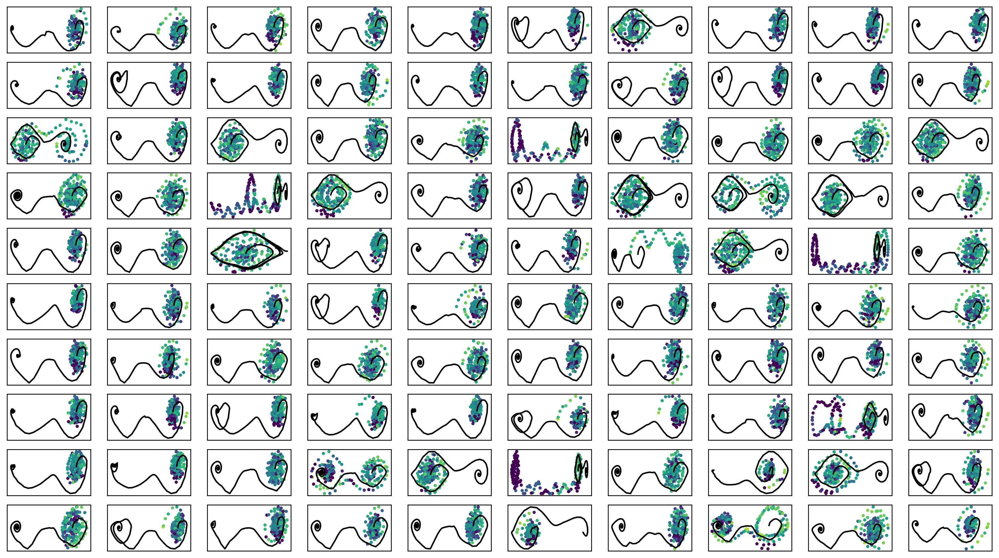

In [28]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter2.png")

In [29]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [30]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [31]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()

train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -562.30560  validloss -473.44019±0.00000  bestvalidloss -473.44019  last_update 0
train: iter 1  trainloss -579.65922  validloss -513.58737±0.00000  bestvalidloss -513.58737  last_update 0
train: iter 2  trainloss -571.22827  validloss -490.51583±0.00000  bestvalidloss -513.58737  last_update 1
train: iter 3  trainloss -576.68074  validloss -475.45366±0.00000  bestvalidloss -513.58737  last_update 2
train: iter 4  trainloss -576.78841  validloss -495.10982±0.00000  bestvalidloss -513.58737  last_update 3
train: iter 5  trainloss -575.33779  validloss -502.73771±0.00000  bestvalidloss -513.58737  last_update 4
train: iter 6  trainloss -580.49869  validloss -500.43547±0.00000  bestvalidloss -513.58737  last_update 5
train: iter 7  trainloss -519.71872  validloss -435.35931±0.00000  bestvalidloss -513.58737  last_update 6
train: iter 8  trainloss -568.49430  validloss -517.18489±0.00000  bestvalidloss -517.18489  last_u

train: iter 76  trainloss -578.95691  validloss -505.27646±0.00000  bestvalidloss -529.37793  last_update 7
train: iter 77  trainloss -579.79567  validloss -498.26324±0.00000  bestvalidloss -529.37793  last_update 8
train: iter 78  trainloss -564.61171  validloss -504.04331±0.00000  bestvalidloss -529.37793  last_update 9
train: iter 79  trainloss -578.41786  validloss -523.57178±0.00000  bestvalidloss -529.37793  last_update 10
train: iter 80  trainloss -577.63125  validloss -515.19550±0.00000  bestvalidloss -529.37793  last_update 11
train: iter 81  trainloss -578.39419  validloss -513.89431±0.00000  bestvalidloss -529.37793  last_update 12
train: iter 82  trainloss -572.01086  validloss -519.85229±0.00000  bestvalidloss -529.37793  last_update 13
train: iter 83  trainloss -562.29186  validloss -493.03415±0.00000  bestvalidloss -529.37793  last_update 14
train: iter 84  trainloss -581.29257  validloss -506.04762±0.00000  bestvalidloss -529.37793  last_update 15
train: iter 85  trainl

train: iter 151  trainloss -556.91703  validloss -475.40034±0.00000  bestvalidloss -531.13852  last_update 43
train: iter 152  trainloss -584.99582  validloss -498.48168±0.00000  bestvalidloss -531.13852  last_update 44
train: iter 153  trainloss -580.08993  validloss -508.18280±0.00000  bestvalidloss -531.13852  last_update 45
train: iter 154  trainloss -584.44091  validloss -514.68211±0.00000  bestvalidloss -531.13852  last_update 46
train: iter 155  trainloss -581.21141  validloss -512.49003±0.00000  bestvalidloss -531.13852  last_update 47
train: iter 156  trainloss -580.46181  validloss -500.57769±0.00000  bestvalidloss -531.13852  last_update 48
train: iter 157  trainloss -562.60604  validloss -519.58718±0.00000  bestvalidloss -531.13852  last_update 49
train: iter 158  trainloss -587.31441  validloss -528.24530±0.00000  bestvalidloss -531.13852  last_update 50
train: iter 159  trainloss -584.49658  validloss -515.47798±0.00000  bestvalidloss -531.13852  last_update 51
train: ite

train: iter 226  trainloss -568.22174  validloss -516.50579±0.00000  bestvalidloss -538.27421  last_update 21
train: iter 227  trainloss -586.62513  validloss -490.80151±0.00000  bestvalidloss -538.27421  last_update 22
train: iter 228  trainloss -588.86048  validloss -534.49066±0.00000  bestvalidloss -538.27421  last_update 23
train: iter 229  trainloss -588.94462  validloss -517.00704±0.00000  bestvalidloss -538.27421  last_update 24
train: iter 230  trainloss -592.70223  validloss -522.35859±0.00000  bestvalidloss -538.27421  last_update 25
train: iter 231  trainloss -591.00567  validloss -510.30235±0.00000  bestvalidloss -538.27421  last_update 26
train: iter 232  trainloss -571.72693  validloss -442.42260±0.00000  bestvalidloss -538.27421  last_update 27
train: iter 233  trainloss -569.34874  validloss -437.03768±0.00000  bestvalidloss -538.27421  last_update 28
train: iter 234  trainloss -582.83063  validloss -470.05848±0.00000  bestvalidloss -538.27421  last_update 29
train: ite

train: iter 301  trainloss -587.51865  validloss -481.84242±0.00000  bestvalidloss -538.27421  last_update 96
train: iter 302  trainloss -575.21562  validloss -500.45944±0.00000  bestvalidloss -538.27421  last_update 97
train: iter 303  trainloss -581.67191  validloss -473.32163±0.00000  bestvalidloss -538.27421  last_update 98
train: iter 304  trainloss -565.79840  validloss -485.64872±0.00000  bestvalidloss -538.27421  last_update 99
train: iter 305  trainloss -584.35498  validloss -440.56133±0.00000  bestvalidloss -538.27421  last_update 100
train: fin
weight_alpha 0.1
weight_alpha 0.1


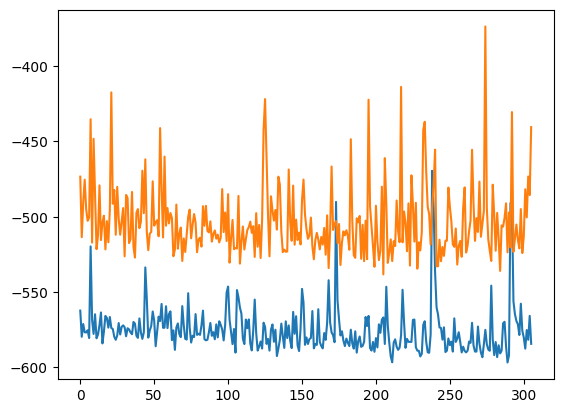

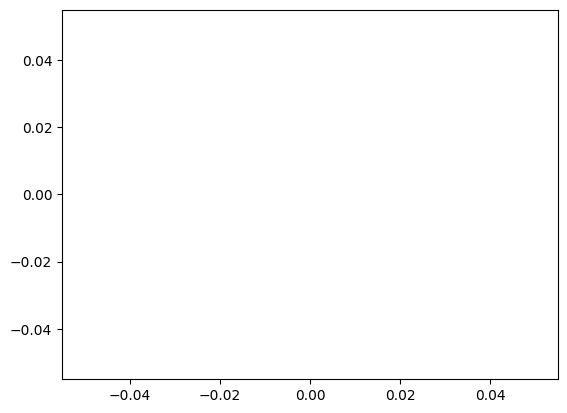

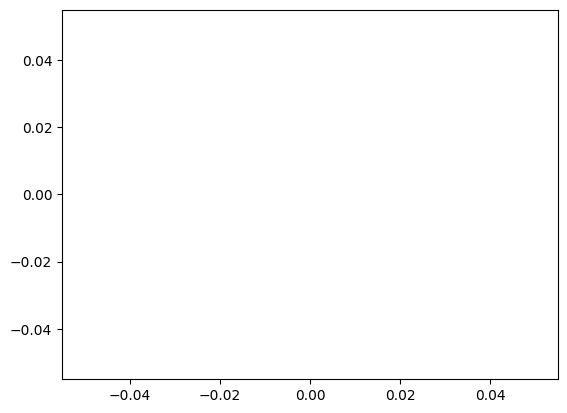

alpha 0.1 vae_lr 0.0005


In [32]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

plt.plot(train_curve2)
plt.plot(valid_curve2)
plt.show()

plt.plot(train_curve3)
plt.plot(valid_curve3)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)

In [33]:
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)



 0 9.5367431640625e-07

 1 3.0757758617401123

 2 3.2591054439544678

 3 3.2256667613983154

 4 3.051254987716675

 5 3.3192007541656494

 6 3.1696481704711914

 7 3.102052688598633

 8 3.3196001052856445

 9 3.168112277984619

 10 3.1248042583465576

 11 3.068084239959717

 12 3.100351572036743

 13 3.095494508743286

 14 3.096312999725342

 15 3.15769100189209

 16 3.0994577407836914

 17 3.0889108180999756

 18 3.180699348449707

 19 3.1259267330169678

 20 3.1539156436920166

 21 3.1219120025634766

 22 3.218427896499634

 23 3.0916154384613037

 24 3.024287223815918

 25 3.692676544189453

 26 6.764386892318726

 27 6.75735068321228

 28 6.732023477554321

 29 6.600123882293701

 30 6.624674320220947

 31 6.873893737792969

 32 7.161777973175049

 33 6.729697942733765

 34 6.6722917556762695

 35 6.695657014846802

 36 6.479893445968628

 37 6.600524187088013

 38 3.2404799461364746

 39 3.2369680404663086

 40 3.176316499710083

 41 3.2055160999298096

 42 3.0237622261047363

 4

実環境方策rollout vs Sim環境方策rollout


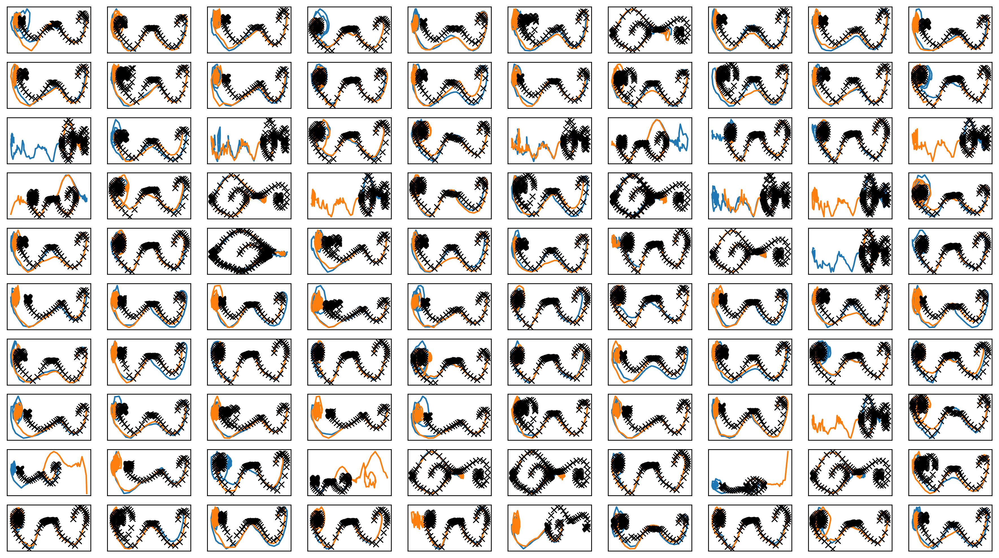

In [34]:

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter2.png")
plt.savefig(figfilenamehead+"joint_iter2.eps")
# plt.savefig(figfilenamehead+"joint_iter2.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

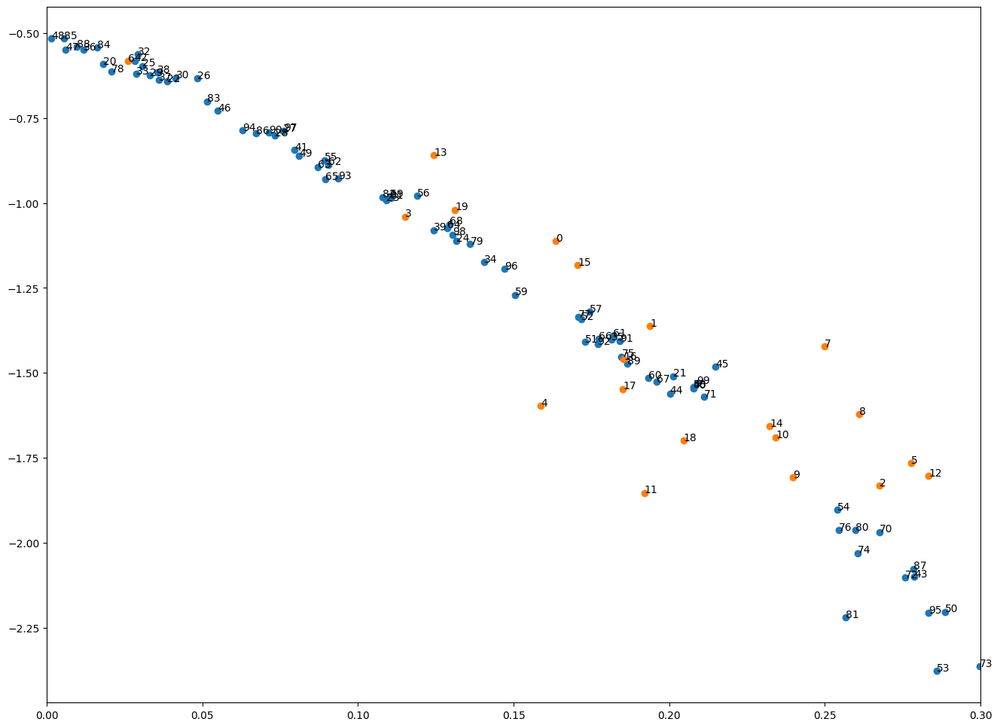

[0.16346495 0.19376823 0.2675319  0.11503246 0.15866848 0.27767899
 0.02613879 0.24978595 0.26100364 0.23974757]
[0.23415875 0.19197631 0.28340068 0.12439858 0.23227011 0.17053018
 0.18529065 0.1850802  0.20454609 0.13110959]
[0.01806764 0.20119136 0.03867789 0.10911323 0.13158045 0.03061344
 0.04839286 0.07598748 0.07332768 0.03311254]
[0.04145489 0.11061755 0.02913038 0.02882952 0.14059536 0.18145366
 0.01175634 0.03605897 0.03561832 0.1242789 ]
[0.20774164 0.07961685 0.02818215 0.27878886 0.20022311 0.21489816
 0.05495741 0.00603226 0.00140864 0.08100239]
[0.28865656 0.1728472  0.17167557 0.2858247  0.2539226  0.08923109
 0.11895172 0.17438186 0.20775948 0.15039731]
[0.19319706 0.18191796 0.09047245 0.08702328 0.12863061 0.0894847
 0.17726183 0.19596025 0.12942553 0.11026856]
[0.26757701 0.21116658 0.27584478 0.2996541  0.26043782 0.18466787
 0.25440247 0.17073022 0.0207501  0.1360628 ]
[0.2599147  0.256741   0.10799342 0.0514889  0.0163014  0.00555654
 0.06717741 0.27842439 0.00955

In [35]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter2.png")
plt.savefig(figfilenamehead+"damping_latent_iter2.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter2.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [36]:
print(datetime.datetime.now())

2023-05-10 15:30:25.807386


# Iter 3

In [37]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0
predict diverge [ 1.77286378e+01 -1.91027624e+07] sim_timestep 31
predict diverge [ 9.13698345e+00 -2.40736309e+07] sim_timestep 32
predict diverge [6.74385796e-01 2.09959646e+07] sim_timestep 33
predict diverge [ 8.88996400e+00 -2.88052554e+04] sim_timestep 34
predict diverge [ 3.95784963e-01 -1.28287804e+07] sim_timestep 35
predict diverge [   -8.17796708 -7460.09405702] sim_timestep 36
predict diverge [-1.73747530e+01  8.31025865e+04] sim_timestep 37
predict diverge [-9.02920838e+00  1.16686161e+05] sim_timestep 38
predict diverge [-8.87961130e-01  1.73216261e+06] sim_timestep 39
predict diverge [7.24112284e+00 5.72458442e+04] sim_timestep 40
predict diverge [ 1.45371792e+01 -1.51989277e+06] sim_timestep 41
predict diverge [ 6.15668348e+00 -1.96942112e+07] sim_timestep 42
predict diverge [-2.57226156e+00  1.87477055e+05] sim_timestep 43
predict diverge [5.51604635e+00 3.68530140e+05] sim_timestep 44
predict diverge [ 1.28916379e+01 -7.80208883e+05] sim_timestep 45
predict diverg

predict diverge [   -5.09525447 -1932.59605599] sim_timestep 90
predict diverge [  -14.13639845 10952.56488857] sim_timestep 91
predict diverge [-5.74916279e+00 -1.94272150e+06] sim_timestep 92
predict diverge [-1.48428011e+01  6.62102442e+04] sim_timestep 93
predict diverge [-6.44723070e+00  1.77211544e+06] sim_timestep 94
predict diverge [ 1.63792316e+00 -2.75143002e+05] sim_timestep 95
predict diverge [  -6.8563742  2030.27278893] sim_timestep 96
predict diverge [ 1.22709410e+00 -2.23686424e+06] sim_timestep 97
predict diverge [-7.22530891e+00  1.34642501e+04] sim_timestep 98
predict diverge [8.65145734e-01 4.69236586e+05] sim_timestep 99
predict diverge [ 9.05954302e+00 -1.24118056e+05] sim_timestep 100
predict diverge [5.35085579e-01 5.04554186e+06] sim_timestep 101
predict diverge [ 8.71450510e+00 -2.05700349e+05] sim_timestep 102
predict diverge [ 1.80802564e-01 -3.14166586e+06] sim_timestep 103
predict diverge [  -8.41278443 4016.74635097] sim_timestep 104
predict diverge [-2.5

predict diverge [-3.35578893e+01  9.92883041e+04] sim_timestep 84
predict diverge [-2.52081614e+01  2.11759530e+06] sim_timestep 85
predict diverge [-1.67836185e+01  1.51007798e+06] sim_timestep 86
predict diverge [-8.35846758e+00  3.53300275e+05] sim_timestep 87
predict diverge [-2.47403403e-01 -1.83659084e+06] sim_timestep 88
predict diverge [-8.76564883e+00 -2.14389708e+04] sim_timestep 89
predict diverge [-1.79648584e+01 -1.18800807e+05] sim_timestep 90
predict diverge [-2.71554516e+01  1.11209071e+05] sim_timestep 91
predict diverge [-1.88402667e+01  1.14382749e+05] sim_timestep 92
predict diverge [-1.04163680e+01 -6.59919926e+05] sim_timestep 93
predict diverge [-1.97293086e+01  3.98274564e+05] sim_timestep 94
predict diverge [-1.13380947e+01 -4.49670523e+05] sim_timestep 95
predict diverge [-2.06406199e+01  2.22446830e+05] sim_timestep 96
predict diverge [-1.22715156e+01 -6.37016749e+06] sim_timestep 97
predict diverge [-2.15011973e+01  8.05048768e+04] sim_timestep 98
predict di

predict diverge [4.33765319e+01 4.12570909e+05] sim_timestep 111
predict diverge [ 5.12268519e+01 -4.94007612e+08] sim_timestep 112
predict diverge [4.32925948e+01 3.01577775e+07] sim_timestep 113
predict diverge [5.12597953e+01 5.54494474e+09] sim_timestep 114
predict diverge [5.92192730e+01 1.20875184e+09] sim_timestep 115
predict diverge [ 6.71581352e+01 -8.33229819e+08] sim_timestep 116
predict diverge [6.30878267e+01 7.54385718e+05] sim_timestep 117
predict diverge [7.07198294e+01 4.51255478e+08] sim_timestep 118
predict diverge [7.83922776e+01 1.42211067e+07] sim_timestep 119
predict diverge [8.58509800e+01 3.88153129e+07] sim_timestep 120
predict diverge [9.33161141e+01 1.91237435e+07] sim_timestep 121
predict diverge [1.00531689e+02 4.75272677e+05] sim_timestep 122
predict diverge [1.0690598e+02 1.2759940e+05] sim_timestep 123
predict diverge [1.06979622e+02 2.67381378e+05] sim_timestep 124
predict diverge [1.06978124e+02 4.00304067e+05] sim_timestep 125
predict diverge [1.0701


 10
predict diverge [  11.63267189 -131.77318708] sim_timestep 27
predict diverge [3.15861652e+00 8.54866201e+07] sim_timestep 28
predict diverge [ 1.07845210e+01 -1.16741281e+05] sim_timestep 29
predict diverge [2.42755081e+00 6.68847767e+07] sim_timestep 30
predict diverge [1.03016331e+01 2.18960015e+05] sim_timestep 31
predict diverge [ 1.78846383e+01 -6.66526383e+07] sim_timestep 32
predict diverge [1.03428416e+01 2.29531600e+08] sim_timestep 33
predict diverge [1.79461583e+01 9.68697809e+07] sim_timestep 34
predict diverge [ 2.57759155e+01 -1.45278824e+10] sim_timestep 35
predict diverge [ 1.78779730e+01 -6.91709622e+08] sim_timestep 36
predict diverge [8.91742328e+00 2.03290856e+08] sim_timestep 37
predict diverge [1.63756559e+01 1.90570098e+07] sim_timestep 38
predict diverge [ 2.42000660e+01 -2.40643419e+09] sim_timestep 39
predict diverge [1.39717998e+01 8.27183460e+08] sim_timestep 40
predict diverge [ 2.18564754e+01 -5.74553452e+08] sim_timestep 41
predict diverge [1.405149

predict diverge [-3.24673984e+01 -5.39406367e+05] sim_timestep 124
predict diverge [-4.15872572e+01  1.12602343e+05] sim_timestep 125
predict diverge [-3.32029362e+01 -3.01082054e+05] sim_timestep 126
predict diverge [-4.23427448e+01 -1.02644195e+07] sim_timestep 127
predict diverge [-5.12889720e+01 -7.01484716e+06] sim_timestep 128
predict diverge [-6.03621691e+01  5.89392968e+05] sim_timestep 129
predict diverge [-5.20172747e+01 -8.90035738e+05] sim_timestep 130
predict diverge [-6.07530613e+01  1.34470886e+07] sim_timestep 131
predict diverge [-5.24411264e+01  1.87450682e+05] sim_timestep 132
predict diverge [-4.40773836e+01 -1.09371608e+06] sim_timestep 133
predict diverge [-5.28937435e+01  1.32312402e+07] sim_timestep 134
predict diverge [-4.45641563e+01  4.63076392e+05] sim_timestep 135
predict diverge [-3.61882529e+01 -1.59655578e+05] sim_timestep 136
predict diverge [-4.51855586e+01 -5.85356967e+06] sim_timestep 137
predict diverge [-5.42029495e+01 -2.03577022e+07] sim_timestep

predict diverge [ 2.23393160e+01 -7.66625087e+09] sim_timestep 57
predict diverge [ 1.06544992e+01 -3.23325925e+08] sim_timestep 58
predict diverge [2.33063610e+00 2.07968105e+08] sim_timestep 59
predict diverge [1.02131024e+01 6.95769440e+04] sim_timestep 60

 15
predict diverge [  12.4316307  -379.14617871] sim_timestep 55
predict diverge [ 3.92436997e+00 -4.21102283e+07] sim_timestep 56
predict diverge [ -4.67316246 202.89092626] sim_timestep 57
predict diverge [ 3.36750966e+00 -2.70904325e+05] sim_timestep 58
predict diverge [   -5.15335251 -1245.70970365] sim_timestep 59
predict diverge [  -14.20912888 -1586.26665134] sim_timestep 60
predict diverge [-2.34306088e+01 -6.54040537e+05] sim_timestep 61
predict diverge [-3.29330949e+01  3.53695142e+05] sim_timestep 62
predict diverge [-2.46609469e+01  3.91573677e+04] sim_timestep 63
predict diverge [-1.63760389e+01 -2.07700388e+06] sim_timestep 64
predict diverge [-2.56332650e+01  1.12283518e+05] sim_timestep 65

 16
predict diverge [1

predict diverge [-5.63187030e+01  9.32756236e+06] sim_timestep 73
predict diverge [-4.81387451e+01  2.83789825e+05] sim_timestep 74
predict diverge [-3.99434936e+01 -3.38255547e+05] sim_timestep 75
predict diverge [-4.92372820e+01  8.96483661e+06] sim_timestep 76
predict diverge [-4.09874388e+01 -1.53031774e+05] sim_timestep 77
predict diverge [-5.01806694e+01 -5.66842987e+06] sim_timestep 78
predict diverge [-5.92859746e+01  1.50897274e+07] sim_timestep 79
predict diverge [-5.10861114e+01  1.56431614e+05] sim_timestep 80
predict diverge [-4.28774996e+01 -4.93873797e+05] sim_timestep 81
predict diverge [-5.23820998e+01  3.94093688e+06] sim_timestep 82
predict diverge [-4.41815549e+01 -1.98359785e+05] sim_timestep 83
predict diverge [-5.30439701e+01 -6.70776486e+06] sim_timestep 84
predict diverge [-6.16806225e+01 -7.05013566e+06] sim_timestep 85
predict diverge [-7.16456506e+01 -1.72324264e+07] sim_timestep 86
predict diverge [-7.81371991e+01  1.17243581e+06] sim_timestep 87
predict di

predict diverge [  -75.08369412 51491.22838447] sim_timestep 107
predict diverge [-6.69254879e+01 -1.01841723e+06] sim_timestep 108
predict diverge [-7.49671558e+01  1.18967224e+07] sim_timestep 109
predict diverge [-6.67727093e+01  7.63729164e+04] sim_timestep 110
predict diverge [-5.85988695e+01 -2.26766475e+05] sim_timestep 111
predict diverge [-6.64122271e+01 -3.88661333e+06] sim_timestep 112
predict diverge [-7.46544397e+01  3.42885671e+05] sim_timestep 113
predict diverge [-6.64943865e+01  1.91768878e+06] sim_timestep 114
predict diverge [-5.83376266e+01  6.23861719e+05] sim_timestep 115
predict diverge [-5.01138929e+01 -1.07762329e+05] sim_timestep 116
predict diverge [-5.91345471e+01 -9.77313194e+06] sim_timestep 117
predict diverge [-6.80389290e+01 -2.44135112e+07] sim_timestep 118
predict diverge [-7.6883062e+01  1.0364651e+07] sim_timestep 119
predict diverge [-6.86297104e+01  1.69300523e+05] sim_timestep 120
predict diverge [-6.04900737e+01  3.39499359e+05] sim_timestep 121

predict diverge [7.62095774e+00 5.81440936e+07] sim_timestep 81
predict diverge [ 1.49413555e+01 -9.21575943e+06] sim_timestep 82
predict diverge [ 6.76971533e+00 -8.88111669e+07] sim_timestep 83
predict diverge [-1.89060610e+00  2.81391182e+05] sim_timestep 84
predict diverge [ 6.26439085e+00 -1.59752742e+05] sim_timestep 85
predict diverge [-2.42362296e+00  2.50689604e+05] sim_timestep 86
predict diverge [5.66739183e+00 2.08555061e+05] sim_timestep 87
predict diverge [1.30172977e+01 7.41239520e+05] sim_timestep 88
predict diverge [2.07209764e+01 6.78440419e+08] sim_timestep 89
predict diverge [2.83573010e+01 1.09541681e+08] sim_timestep 90
predict diverge [3.59387325e+01 4.40485520e+08] sim_timestep 91
predict diverge [4.34462616e+01 8.92585761e+07] sim_timestep 92
predict diverge [ 5.11391400e+01 -7.55787234e+06] sim_timestep 93
predict diverge [ 4.39472546e+01 -1.18625718e+06] sim_timestep 94
predict diverge [3.96079604e+01 4.43130458e+06] sim_timestep 95
predict diverge [4.7115639

predict diverge [-3.10158513e+01 -5.46869652e+05] sim_timestep 104
predict diverge [-4.03468005e+01 -6.86647168e+06] sim_timestep 105
predict diverge [-4.95066597e+01 -4.04938466e+06] sim_timestep 106
predict diverge [-5.83567869e+01  1.21271478e+07] sim_timestep 107
predict diverge [-5.01021803e+01 -4.51189361e+05] sim_timestep 108
predict diverge [-5.91579801e+01 -5.32088675e+06] sim_timestep 109
predict diverge [-6.72615114e+01 -3.93530719e+06] sim_timestep 110
predict diverge [-7.60278492e+01  1.53013238e+07] sim_timestep 111
predict diverge [-6.76643138e+01  2.24684846e+05] sim_timestep 112
predict diverge [-5.94886141e+01  9.31796034e+05] sim_timestep 113
predict diverge [-5.12066943e+01  1.29234695e+05] sim_timestep 114
predict diverge [-4.26727031e+01 -4.00876530e+05] sim_timestep 115
predict diverge [-5.15986315e+01  1.42360513e+06] sim_timestep 116
predict diverge [-4.3367861e+01  1.9762391e+05] sim_timestep 117
predict diverge [-3.50988617e+01 -8.54973136e+05] sim_timestep 1


 60

 61

 62

 63
predict diverge [  11.07637169 4795.0445989 ] sim_timestep 34
predict diverge [ 1.84497567e+01 -1.73686662e+07] sim_timestep 35
predict diverge [1.00113466e+01 1.94541734e+06] sim_timestep 36
predict diverge [ 1.73692210e+01 -2.17343271e+07] sim_timestep 37
predict diverge [8.72984377e+00 4.58834173e+06] sim_timestep 38
predict diverge [ 1.60399276e+01 -5.15221647e+06] sim_timestep 39
predict diverge [7.51860058e+00 5.85666019e+05] sim_timestep 40
predict diverge [ 1.47800760e+01 -4.07538702e+06] sim_timestep 41
predict diverge [ 6.23300660e+00 -2.48508371e+06] sim_timestep 42
predict diverge [-2.49347590e+00  7.67530194e+04] sim_timestep 43
predict diverge [5.61005452e+00 1.28570294e+05] sim_timestep 44
predict diverge [1.29793168e+01 2.87774551e+05] sim_timestep 45
predict diverge [ 2.03476231e+01 -4.42504163e+07] sim_timestep 46
predict diverge [1.18124484e+01 1.75833578e+06] sim_timestep 47
predict diverge [1.91637782e+01 1.23966286e+07] sim_timestep 48
predict 


 71

 72

 73

 74

 75

 76

 77

 78

 79
predict diverge [ 11.4604787  273.55540713] sim_timestep 48
predict diverge [1.89600291e+01 8.87049172e+07] sim_timestep 49
predict diverge [2.63931597e+01 4.85266005e+06] sim_timestep 50
predict diverge [ 3.37770674e+01 -6.15217788e+07] sim_timestep 51
predict diverge [ 2.45504376e+01 -2.94619055e+06] sim_timestep 52
predict diverge [1.54264867e+01 2.17515046e+07] sim_timestep 53
predict diverge [2.28996305e+01 6.61771518e+07] sim_timestep 54
predict diverge [3.03206182e+01 1.36550706e+08] sim_timestep 55
predict diverge [ 3.76704573e+01 -6.02204928e+07] sim_timestep 56
predict diverge [2.72461672e+01 1.49072793e+06] sim_timestep 57
predict diverge [3.46547831e+01 4.95465556e+07] sim_timestep 58
predict diverge [4.20140381e+01 6.62176877e+07] sim_timestep 59
predict diverge [ 4.93514901e+01 -5.36687425e+06] sim_timestep 60
predict diverge [   39.49206222 24804.66741974] sim_timestep 61
predict diverge [4.68324967e+01 2.86429873e+05] sim_tim

predict diverge [ 2.21555329e+01 -2.78357652e+07] sim_timestep 164
predict diverge [1.34357218e+01 1.00786781e+07] sim_timestep 165
predict diverge [2.08916700e+01 1.74232707e+08] sim_timestep 166
predict diverge [2.83303421e+01 7.57724161e+07] sim_timestep 167
predict diverge [3.57074014e+01 3.87359583e+07] sim_timestep 168
predict diverge [ 4.30609381e+01 -1.37957492e+07] sim_timestep 169
predict diverge [3.46221013e+01 3.45422171e+05] sim_timestep 170
predict diverge [ 4.19178827e+01 -2.70096355e+07] sim_timestep 171
predict diverge [3.35121265e+01 6.67950767e+05] sim_timestep 172
predict diverge [4.08511716e+01 5.37932363e+07] sim_timestep 173
predict diverge [4.82719905e+01 2.86103458e+07] sim_timestep 174
predict diverge [5.57547103e+01 1.47122400e+07] sim_timestep 175
predict diverge [6.31782159e+01 8.63114492e+06] sim_timestep 176
predict diverge [ 7.05093030e+01 -2.87573475e+06] sim_timestep 177
predict diverge [  60.00304118 6053.02975111] sim_timestep 178
predict diverge [6.

In [38]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
# iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)



train: iter 0  trainloss 0.29736  validloss 0.22514±0.00000  bestvalidloss 0.22514  last_update 0
train: iter 1  trainloss 0.27879  validloss 0.21717±0.00000  bestvalidloss 0.21717  last_update 0
train: iter 2  trainloss 0.27810  validloss 0.21477±0.00000  bestvalidloss 0.21477  last_update 0
train: iter 3  trainloss 0.27319  validloss 0.21807±0.00000  bestvalidloss 0.21477  last_update 1
train: iter 4  trainloss 0.27569  validloss 0.21549±0.00000  bestvalidloss 0.21477  last_update 2
train: iter 5  trainloss 0.27545  validloss 0.21537±0.00000  bestvalidloss 0.21477  last_update 3
train: iter 6  trainloss 0.27192  validloss 0.21634±0.00000  bestvalidloss 0.21477  last_update 4
train: iter 7  trainloss 0.27233  validloss 0.21484±0.00000  bestvalidloss 0.21477  last_update 5
train: iter 8  trainloss 0.27023  validloss 0.22328±0.00000  bestvalidloss 0.21477  last_update 6
train: iter 9  trainloss 0.26856  validloss 0.21386±0.00000  bestvalidloss 0.21386  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.25442  validloss 0.20703±0.00000  bestvalidloss 0.20373  last_update 13
train: iter 84  trainloss 0.25538  validloss 0.21057±0.00000  bestvalidloss 0.20373  last_update 14
train: iter 85  trainloss 0.25279  validloss 0.20746±0.00000  bestvalidloss 0.20373  last_update 15
train: iter 86  trainloss 0.25837  validloss 0.20846±0.00000  bestvalidloss 0.20373  last_update 16
train: iter 87  trainloss 0.25514  validloss 0.20702±0.00000  bestvalidloss 0.20373  last_update 17
train: iter 88  trainloss 0.25586  validloss 0.21108±0.00000  bestvalidloss 0.20373  last_update 18
train: iter 89  trainloss 0.25465  validloss 0.20953±0.00000  bestvalidloss 0.20373  last_update 19
train: iter 90  trainloss 0.25380  validloss 0.20951±0.00000  bestvalidloss 0.20373  last_update 20
train: iter 91  trainloss 0.25571  validloss 0.21008±0.00000  bestvalidloss 0.20373  last_update 21
train: iter 92  trainloss 0.25261  validloss 0.20874±0.00000  bestvalidloss 0.20373  last_update 22


train: iter 165  trainloss 0.25242  validloss 0.21059±0.00000  bestvalidloss 0.20367  last_update 11
train: iter 166  trainloss 0.24751  validloss 0.20562±0.00000  bestvalidloss 0.20367  last_update 12
train: iter 167  trainloss 0.24842  validloss 0.21202±0.00000  bestvalidloss 0.20367  last_update 13
train: iter 168  trainloss 0.24735  validloss 0.21321±0.00000  bestvalidloss 0.20367  last_update 14
train: iter 169  trainloss 0.24858  validloss 0.20759±0.00000  bestvalidloss 0.20367  last_update 15
train: iter 170  trainloss 0.24678  validloss 0.21551±0.00000  bestvalidloss 0.20367  last_update 16
train: iter 171  trainloss 0.24787  validloss 0.20707±0.00000  bestvalidloss 0.20367  last_update 17
train: iter 172  trainloss 0.24633  validloss 0.21383±0.00000  bestvalidloss 0.20367  last_update 18
train: iter 173  trainloss 0.24653  validloss 0.20912±0.00000  bestvalidloss 0.20367  last_update 19
train: iter 174  trainloss 0.24661  validloss 0.20681±0.00000  bestvalidloss 0.20367  last_

train: iter 247  trainloss 0.24023  validloss 0.21209±0.00000  bestvalidloss 0.20367  last_update 93
train: iter 248  trainloss 0.24079  validloss 0.21433±0.00000  bestvalidloss 0.20367  last_update 94
train: iter 249  trainloss 0.24295  validloss 0.21245±0.00000  bestvalidloss 0.20367  last_update 95
train: iter 250  trainloss 0.24029  validloss 0.21244±0.00000  bestvalidloss 0.20367  last_update 96
train: iter 251  trainloss 0.24232  validloss 0.21081±0.00000  bestvalidloss 0.20367  last_update 97
train: iter 252  trainloss 0.24119  validloss 0.21911±0.00000  bestvalidloss 0.20367  last_update 98
train: iter 253  trainloss 0.24175  validloss 0.21379±0.00000  bestvalidloss 0.20367  last_update 99
train: iter 254  trainloss 0.24301  validloss 0.21082±0.00000  bestvalidloss 0.20367  last_update 100
train: fin


([0.29735574615187943,
  0.27879222547635435,
  0.2780971908941865,
  0.27319009145721795,
  0.275686706835404,
  0.27544839889742434,
  0.27191892005503177,
  0.27233251091092825,
  0.27022623689845204,
  0.26856330605223777,
  0.2684468487277627,
  0.26953339665196835,
  0.26734056081622837,
  0.26721356515772643,
  0.26827215468510984,
  0.26903259828686715,
  0.26667205705307423,
  0.2663961139507592,
  0.26654785173013806,
  0.26540243104100225,
  0.26714044651016594,
  0.2648186886217445,
  0.2659336698241532,
  0.2659031837247312,
  0.26398912905715405,
  0.2679438610561192,
  0.26437007477506996,
  0.2652529033832252,
  0.2625500587746501,
  0.26358460569754244,
  0.26358494320884346,
  0.2649754154030234,
  0.26321092061698437,
  0.2631726773455739,
  0.2625398177653551,
  0.2609317285008729,
  0.2632593149319291,
  0.2620045795105398,
  0.26029617195017635,
  0.263940320443362,
  0.2599360588006675,
  0.26185968713834884,
  0.2595383498817682,
  0.26052867295220494,
  0.26017

In [39]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -351.15189419031145
valid_loss:  -152.67997723579407
train_loss:  -606.512171702385
valid_loss:  -522.542211227417


1e-08 1000.0


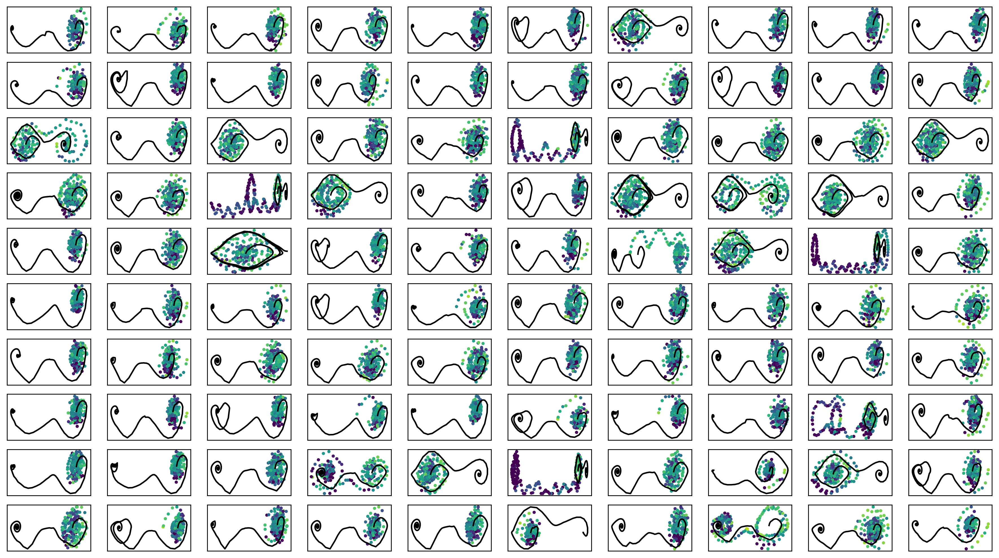

In [40]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter3.png")

In [41]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [42]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [43]:
# i = 49
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

In [44]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()

train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -598.23587  validloss -516.10049±0.00000  bestvalidloss -516.10049  last_update 0
train: iter 1  trainloss -574.46658  validloss -537.79729±0.00000  bestvalidloss -537.79729  last_update 0
train: iter 2  trainloss -604.95018  validloss -551.86225±0.00000  bestvalidloss -551.86225  last_update 0
train: iter 3  trainloss -605.05809  validloss -544.48796±0.00000  bestvalidloss -551.86225  last_update 1
train: iter 4  trainloss -598.42040  validloss -540.58111±0.00000  bestvalidloss -551.86225  last_update 2
train: iter 5  trainloss -588.86889  validloss -491.81923±0.00000  bestvalidloss -551.86225  last_update 3
train: iter 6  trainloss -604.71009  validloss -552.16438±0.00000  bestvalidloss -552.16438  last_update 0
train: iter 7  trainloss -606.96682  validloss -547.12057±0.00000  bestvalidloss -552.16438  last_update 1
train: iter 8  trainloss -600.70260  validloss -536.68812±0.00000  bestvalidloss -552.16438  last_u

train: iter 76  trainloss -597.04426  validloss -532.95841±0.00000  bestvalidloss -560.68554  last_update 16
train: iter 77  trainloss -605.09929  validloss -552.57762±0.00000  bestvalidloss -560.68554  last_update 17
train: iter 78  trainloss -603.92470  validloss -542.29689±0.00000  bestvalidloss -560.68554  last_update 18
train: iter 79  trainloss -604.04731  validloss -527.47929±0.00000  bestvalidloss -560.68554  last_update 19
train: iter 80  trainloss -603.98565  validloss -526.69771±0.00000  bestvalidloss -560.68554  last_update 20
train: iter 81  trainloss -602.80460  validloss -545.79587±0.00000  bestvalidloss -560.68554  last_update 21
train: iter 82  trainloss -600.18866  validloss -548.01236±0.00000  bestvalidloss -560.68554  last_update 22
train: iter 83  trainloss -601.98180  validloss -545.63343±0.00000  bestvalidloss -560.68554  last_update 23
train: iter 84  trainloss -598.41909  validloss -506.53222±0.00000  bestvalidloss -560.68554  last_update 24
train: iter 85  tra

train: iter 151  trainloss -573.89128  validloss -525.39111±0.00000  bestvalidloss -560.68554  last_update 91
train: iter 152  trainloss -589.76029  validloss -531.87045±0.00000  bestvalidloss -560.68554  last_update 92
train: iter 153  trainloss -582.01395  validloss -543.06418±0.00000  bestvalidloss -560.68554  last_update 93
train: iter 154  trainloss -605.66266  validloss -552.03266±0.00000  bestvalidloss -560.68554  last_update 94
train: iter 155  trainloss -598.58053  validloss -523.23958±0.00000  bestvalidloss -560.68554  last_update 95
train: iter 156  trainloss -606.51627  validloss -553.66367±0.00000  bestvalidloss -560.68554  last_update 96
train: iter 157  trainloss -607.25567  validloss -540.51044±0.00000  bestvalidloss -560.68554  last_update 97
train: iter 158  trainloss -610.96471  validloss -552.18595±0.00000  bestvalidloss -560.68554  last_update 98
train: iter 159  trainloss -598.65238  validloss -547.51652±0.00000  bestvalidloss -560.68554  last_update 99
train: ite

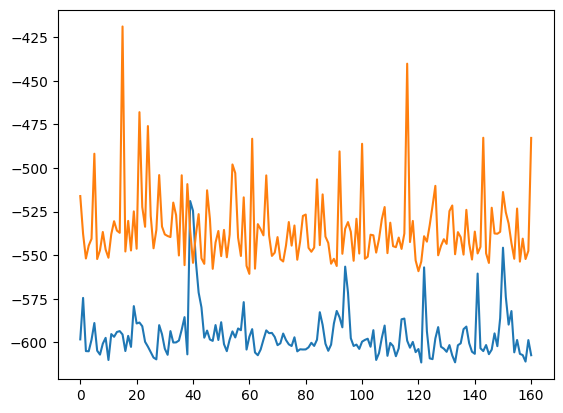

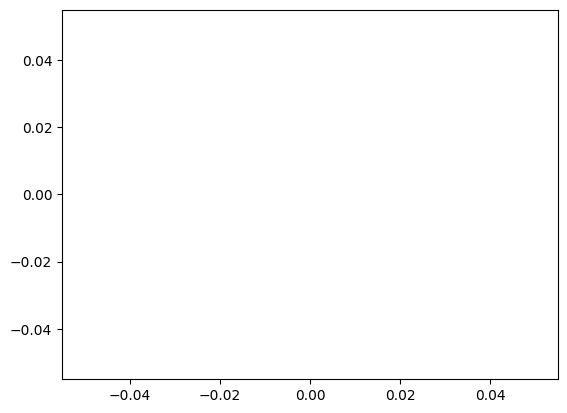

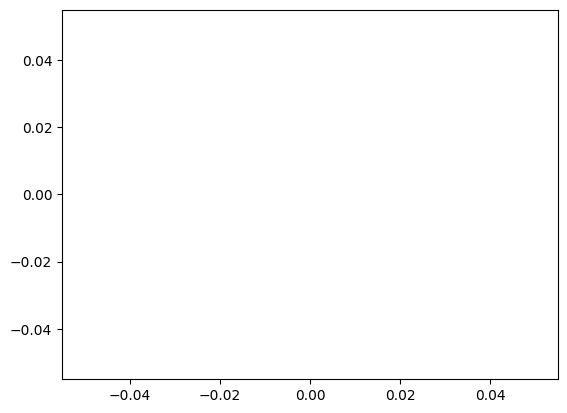

alpha 0.1 vae_lr 0.0005


In [45]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

plt.plot(train_curve2)
plt.plot(valid_curve2)
plt.show()

plt.plot(train_curve3)
plt.plot(valid_curve3)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)

In [46]:
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)




 0 4.76837158203125e-07

 1 3.3781087398529053

 2 3.194605588912964

 3 3.7190823554992676

 4 3.4139041900634766

 5 3.324134349822998

 6 3.655268907546997

 7 6.0957252979278564

 8 5.334437847137451

 9 5.455505847930908

 10 4.575237035751343

 11 4.513609409332275

 12 7.504287004470825

 13 5.545827388763428

 14 6.808160305023193

 15 6.74901819229126

 16 6.351377964019775

 17 7.717743158340454

 18 9.055150032043457

 19 7.36986780166626

 20 4.719802618026733

 21 4.500482797622681

 22 5.909288644790649

 23 6.55186915397644

 24 5.04201602935791

 25 4.679687261581421

 26 4.250313758850098

 27 7.1481544971466064

 28 6.192975997924805

 29 4.659200429916382

 30 4.363997936248779

 31 4.258690118789673

 32 3.304708957672119

 33 3.6350083351135254

 34 6.094275951385498

 35 6.421727895736694

 36 7.378743648529053

 37 4.785804510116577

 38 3.7026727199554443

 39 3.1224112510681152

 40 5.316789150238037

 41 3.202972888946533

 42 3.4395322799682617

 43 3.318819

実環境方策rollout vs Sim環境方策rollout


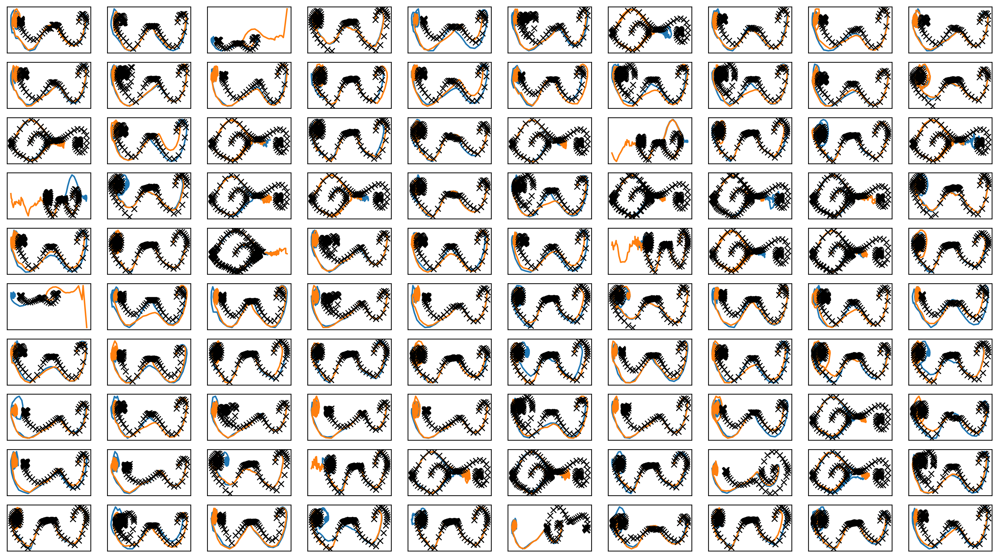

In [47]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter3.png")
plt.savefig(figfilenamehead+"joint_iter3.eps")
# plt.savefig(figfilenamehead+"joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

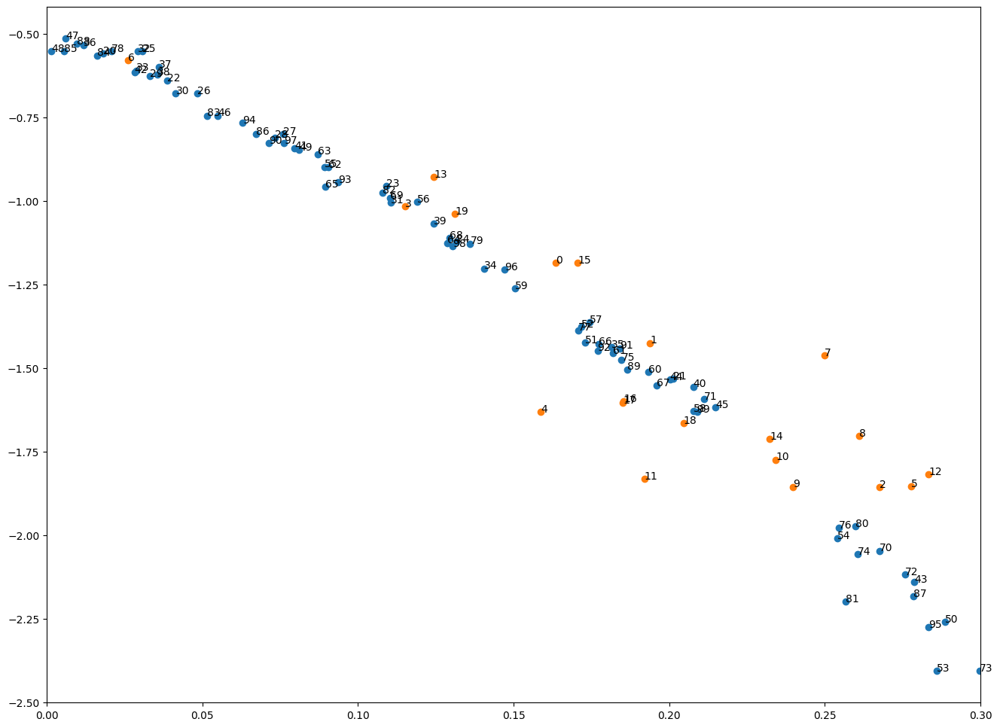

[0.16346495 0.19376823 0.2675319  0.11503246 0.15866848 0.27767899
 0.02613879 0.24978595 0.26100364 0.23974757]
[0.23415875 0.19197631 0.28340068 0.12439858 0.23227011 0.17053018
 0.18529065 0.1850802  0.20454609 0.13110959]
[0.01806764 0.20119136 0.03867789 0.10911323 0.13158045 0.03061344
 0.04839286 0.07598748 0.07332768 0.03311254]
[0.04145489 0.11061755 0.02913038 0.02882952 0.14059536 0.18145366
 0.01175634 0.03605897 0.03561832 0.1242789 ]
[0.20774164 0.07961685 0.02818215 0.27878886 0.20022311 0.21489816
 0.05495741 0.00603226 0.00140864 0.08100239]
[0.28865656 0.1728472  0.17167557 0.2858247  0.2539226  0.08923109
 0.11895172 0.17438186 0.20775948 0.15039731]
[0.19319706 0.18191796 0.09047245 0.08702328 0.12863061 0.0894847
 0.17726183 0.19596025 0.12942553 0.11026856]
[0.26757701 0.21116658 0.27584478 0.2996541  0.26043782 0.18466787
 0.25440247 0.17073022 0.0207501  0.1360628 ]
[0.2599147  0.256741   0.10799342 0.0514889  0.0163014  0.00555654
 0.06717741 0.27842439 0.00955

In [48]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter3.png")
plt.savefig(figfilenamehead+"damping_latent_iter3.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter3.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [49]:
print(datetime.datetime.now())

2023-05-10 16:12:02.714810


# Iter 4

In [50]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0
predict diverge [  12.92900564 2987.52101213] sim_timestep 60
predict diverge [ 2.03900344e+01 -8.69123783e+07] sim_timestep 61
predict diverge [1.25743793e+01 7.83734047e+08] sim_timestep 62
predict diverge [ 2.00322962e+01 -1.27682978e+07] sim_timestep 63
predict diverge [ 1.13390422e+01 -4.11003738e+08] sim_timestep 64
predict diverge [3.04942454e+00 1.38903817e+08] sim_timestep 65
predict diverge [ 1.07681130e+01 -5.79190037e+04] sim_timestep 66
predict diverge [2.44335733e+00 1.91187060e+08] sim_timestep 67
predict diverge [1.03574541e+01 3.05731480e+04] sim_timestep 68
predict diverge [1.78392921e+01 7.82667044e+07] sim_timestep 69
predict diverge [2.52327932e+01 2.87139003e+07] sim_timestep 70
predict diverge [3.25558238e+01 1.66376667e+07] sim_timestep 71
predict diverge [ 3.97519101e+01 -7.45260312e+05] sim_timestep 72
predict diverge [ 3.46006066e+01 -2.70343645e+07] sim_timestep 73
predict diverge [2.63941296e+01 4.49967940e+07] sim_timestep 74
predict diverge [ 3.367623

predict diverge [-3.65311821e+01 -1.58415691e+05] sim_timestep 188
predict diverge [-4.57502116e+01 -8.88044048e+05] sim_timestep 189
predict diverge [-5.49040147e+01  1.20638434e+05] sim_timestep 190
predict diverge [-4.69359033e+01  5.13426104e+05] sim_timestep 191
predict diverge [-3.89609338e+01 -2.27315909e+05] sim_timestep 192
predict diverge [-4.80787152e+01  3.77857920e+06] sim_timestep 193
predict diverge [-4.01191949e+01  4.34976702e+05] sim_timestep 194
predict diverge [-3.20645481e+01 -9.75456084e+05] sim_timestep 195
predict diverge [-4.13356738e+01 -1.66332534e+06] sim_timestep 196
predict diverge [-5.04675009e+01 -7.68759535e+06] sim_timestep 197
predict diverge [-5.96060786e+01 -5.19643110e+06] sim_timestep 198
predict diverge [-6.87013291e+01 -1.95159674e+06] sim_timestep 199
predict diverge [-7.73885385e+01 -2.79992207e+06] sim_timestep 200
predict diverge [-8.66612523e+01 -2.83864368e+06] sim_timestep 201
predict diverge [-9.58816449e+01 -9.14329803e+05] sim_timestep

predict diverge [-8.30624776e+01  2.73839522e+05] sim_timestep 318
predict diverge [  11.04360896 -263.63276753] sim_timestep 25
predict diverge [ 2.78654536e+00 -2.71891799e+08] sim_timestep 26
predict diverge [  -5.70369761 1770.80788363] sim_timestep 27
predict diverge [ 2.11058062e+00 -4.82930821e+05] sim_timestep 28
predict diverge [-6.37061206e+00 -8.88854303e+03] sim_timestep 29
predict diverge [-1.54334334e+01 -6.18851816e+04] sim_timestep 30
predict diverge [  -24.56696002 11260.91214269] sim_timestep 31
predict diverge [-1.64906947e+01  4.74261924e+05] sim_timestep 32
predict diverge [-8.29805203e+00 -1.71021572e+06] sim_timestep 33
predict diverge [-1.75205411e+01  1.63201477e+05] sim_timestep 34
predict diverge [-9.35775516e+00 -9.74099278e+05] sim_timestep 35
predict diverge [-1.86515571e+01  3.73721623e+04] sim_timestep 36
predict diverge [-1.04927044e+01 -5.22028417e+05] sim_timestep 37
predict diverge [-1.97724564e+01  1.55471657e+05] sim_timestep 38
predict diverge [-1

predict diverge [ 7.75093028e+01 -1.17365656e+07] sim_timestep 62
predict diverge [9.19603179e+01 4.96969179e+05] sim_timestep 63
predict diverge [ 9.86490052e+01 -5.79598605e+05] sim_timestep 64
predict diverge [  104.75718217 56146.08124843] sim_timestep 65
predict diverge [   106.51787039 -24487.44118124] sim_timestep 66
predict diverge [  125.98945365 35825.36458712] sim_timestep 67
predict diverge [  106.52421359 -1255.01250387] sim_timestep 68
predict diverge [   87.45203701 48953.85302778] sim_timestep 69
predict diverge [9.42476873e+01 1.12760534e+06] sim_timestep 70
predict diverge [  100.87803244 77700.64286383] sim_timestep 71
predict diverge [1.06542873e+02 2.68191686e+05] sim_timestep 72
predict diverge [1.06514365e+02 1.81590353e+05] sim_timestep 73
predict diverge [   106.48412865 -10537.38834463] sim_timestep 74
predict diverge [   78.67338638 24912.78711867] sim_timestep 75
predict diverge [ 8.56298133e+01 -5.00446579e+06] sim_timestep 76
predict diverge [1.58663960e+0

predict diverge [   10.38388892 -1034.01451019] sim_timestep 40
predict diverge [2.01623327e+00 2.75028314e+07] sim_timestep 41
predict diverge [9.95542459e+00 7.38070358e+04] sim_timestep 42
predict diverge [1.75283226e+01 5.10752549e+07] sim_timestep 43
predict diverge [ 2.52995684e+01 -6.75629868e+09] sim_timestep 44
predict diverge [ 1.69288846e+01 -5.48260847e+08] sim_timestep 45
predict diverge [9.53058750e+00 1.56426993e+09] sim_timestep 46
predict diverge [ 1.70264912e+01 -4.99680306e+07] sim_timestep 47
predict diverge [ 8.45801387e+00 -6.19101132e+09] sim_timestep 48
predict diverge [-6.48953763e-02 -5.94155742e+06] sim_timestep 49
predict diverge [   -8.51372065 -6532.3616338 ] sim_timestep 50
predict diverge [-1.76632487e+01  6.87147902e+04] sim_timestep 51
predict diverge [-9.33598986e+00  3.08860747e+05] sim_timestep 52
predict diverge [-1.42322901e+00 -2.54258895e+05] sim_timestep 53
predict diverge [  -10.01540626 -8815.78884963] sim_timestep 54
predict diverge [-1.9280

predict diverge [-3.90911368e+01 -1.18343082e+06] sim_timestep 101
predict diverge [-4.80360254e+01 -5.22016155e+06] sim_timestep 102
predict diverge [-5.69594533e+01  8.56688165e+05] sim_timestep 103
predict diverge [-4.89318996e+01  7.05169682e+05] sim_timestep 104
predict diverge [-4.08552396e+01  1.41777803e+06] sim_timestep 105
predict diverge [-3.27368325e+01 -3.82425612e+05] sim_timestep 106
predict diverge [-4.18717314e+01  8.49035096e+05] sim_timestep 107
predict diverge [-3.37908353e+01  1.00369670e+05] sim_timestep 108
predict diverge [-2.56394908e+01  5.55504812e+06] sim_timestep 109
predict diverge [-1.72036073e+01 -3.04995086e+06] sim_timestep 110
predict diverge [-2.62276016e+01 -5.72509175e+05] sim_timestep 111
predict diverge [   -35.3187376  -28664.88545932] sim_timestep 112
predict diverge [-4.44143530e+01 -5.35156791e+06] sim_timestep 113
predict diverge [-5.34419332e+01 -1.67805697e+05] sim_timestep 114
predict diverge [-6.23285548e+01 -1.52892937e+06] sim_timestep

predict diverge [ 2.10702719e+01 -9.04896565e+07] sim_timestep 149

 35

 36

 37

 38

 39

 40

 41

 42

 43

 44
predict diverge [3.95302473e+00 4.11531329e+06] sim_timestep 62
predict diverge [1.14097656e+01 3.33639775e+05] sim_timestep 63
predict diverge [1.90759115e+01 2.60820847e+08] sim_timestep 64
predict diverge [ 2.66431898e+01 -8.66331202e+08] sim_timestep 65
predict diverge [1.71914223e+01 5.30452465e+08] sim_timestep 66
predict diverge [ 2.48221039e+01 -7.97793811e+08] sim_timestep 67
predict diverge [1.72947139e+01 9.66814910e+08] sim_timestep 68
predict diverge [2.49068562e+01 2.96744423e+08] sim_timestep 69
predict diverge [3.24485174e+01 1.13588245e+08] sim_timestep 70
predict diverge [ 3.98755840e+01 -2.99795347e+08] sim_timestep 71
predict diverge [2.86347530e+01 8.71395604e+07] sim_timestep 72
predict diverge [ 3.61192152e+01 -2.60071401e+07] sim_timestep 73
predict diverge [ 2.69787156e+01 -3.99063406e+08] sim_timestep 74
predict diverge [2.29090656e+01 2.8941369

predict diverge [-7.89921894e+01  2.80881198e+06] sim_timestep 52
predict diverge [-7.08845143e+01  1.26680935e+05] sim_timestep 53
predict diverge [-6.29429953e+01  7.98831726e+04] sim_timestep 54
predict diverge [-5.49494750e+01 -3.20184268e+05] sim_timestep 55
predict diverge [-6.37157509e+01  2.46144855e+06] sim_timestep 56
predict diverge [-5.57762050e+01 -5.05018298e+05] sim_timestep 57
predict diverge [-6.46334949e+01  4.60460300e+05] sim_timestep 58
predict diverge [-5.66345411e+01  1.70633452e+05] sim_timestep 59
predict diverge [-4.85768708e+01  5.26706361e+05] sim_timestep 60
predict diverge [   -40.48011773 -38032.71256947] sim_timestep 61
predict diverge [-4.94508584e+01  2.80302505e+06] sim_timestep 62
predict diverge [-4.13973732e+01 -1.01406478e+06] sim_timestep 63
predict diverge [-5.03611518e+01  3.87070533e+06] sim_timestep 64
predict diverge [  -42.03802787 -7579.45767689] sim_timestep 65
predict diverge [-5.09553604e+01 -1.54199967e+06] sim_timestep 66
predict dive

predict diverge [-4.69533046e+01 -5.35925718e+06] sim_timestep 124
predict diverge [-5.60420169e+01 -2.09938347e+06] sim_timestep 125
predict diverge [-6.50093027e+01 -1.10563102e+05] sim_timestep 126
predict diverge [-7.36749408e+01  2.81825734e+06] sim_timestep 127
predict diverge [  -65.70977248 27109.15532073] sim_timestep 128
predict diverge [   -57.83008157 -34479.7136924 ] sim_timestep 129
predict diverge [-6.66395852e+01 -4.59300298e+06] sim_timestep 130
predict diverge [-7.53040869e+01 -4.76832737e+06] sim_timestep 131
predict diverge [-8.42733025e+01 -3.41782219e+06] sim_timestep 132
predict diverge [-9.31851282e+01  6.52400982e+05] sim_timestep 133
predict diverge [-8.52548086e+01  1.23584631e+05] sim_timestep 134
predict diverge [-7.72746928e+01 -9.65988525e+04] sim_timestep 135
predict diverge [-8.63227308e+01 -1.33886191e+06] sim_timestep 136
predict diverge [-9.52064677e+01  6.99603207e+05] sim_timestep 137
predict diverge [-8.73158433e+01 -5.71548579e+05] sim_timestep 1

predict diverge [-1.62931738e+01 -3.28449767e+06] sim_timestep 75
predict diverge [-2.52938884e+01 -2.06795149e+05] sim_timestep 76
predict diverge [-3.44755937e+01 -1.62923410e+06] sim_timestep 77
predict diverge [-4.36176137e+01  7.82235338e+06] sim_timestep 78
predict diverge [-3.55183965e+01  1.58662352e+06] sim_timestep 79
predict diverge [-2.74291116e+01  2.22353085e+06] sim_timestep 80
predict diverge [-1.92728454e+01  1.76152571e+06] sim_timestep 81
predict diverge [-1.10509927e+01  6.18930076e+06] sim_timestep 82
predict diverge [-3.08178853e+00 -6.98663003e+05] sim_timestep 83
predict diverge [ -11.8616738  6589.13101111] sim_timestep 84
predict diverge [-3.84871506e+00 -4.46589277e+06] sim_timestep 85
predict diverge [-1.26972317e+01 -2.95224417e+04] sim_timestep 86
predict diverge [-2.18108959e+01  4.97484006e+04] sim_timestep 87
predict diverge [-1.36520615e+01  1.00867154e+06] sim_timestep 88
predict diverge [-5.50911762e+00 -3.21424813e+06] sim_timestep 89
predict diverg

predict diverge [-7.24261166e+01  3.41457274e+05] sim_timestep 82
predict diverge [-6.46532988e+01  8.57408300e+04] sim_timestep 83
predict diverge [-5.68415794e+01  1.10107062e+05] sim_timestep 84
predict diverge [-4.89401324e+01 -1.67677522e+05] sim_timestep 85
predict diverge [-5.80396636e+01  3.67608530e+06] sim_timestep 86
predict diverge [ -50.11507542 8090.68786916] sim_timestep 87
predict diverge [-4.21791446e+01  5.22096151e+05] sim_timestep 88
predict diverge [-3.42317327e+01  3.97430033e+05] sim_timestep 89
predict diverge [-2.62158070e+01 -6.43985558e+05] sim_timestep 90
predict diverge [-3.56167924e+01  1.60510765e+06] sim_timestep 91
predict diverge [-2.75799408e+01  2.42609836e+06] sim_timestep 92
predict diverge [-1.95400107e+01  4.65435919e+05] sim_timestep 93
predict diverge [-1.14334085e+01  9.84837819e+05] sim_timestep 94
predict diverge [-3.41027958e+00  2.00116133e+06] sim_timestep 95
predict diverge [ 4.44331226e+00 -2.78165465e+05] sim_timestep 96
predict diverg

predict diverge [ 8.44273479e+01 -2.26221787e+05] sim_timestep 179
predict diverge [  71.92453055 1881.58355836] sim_timestep 180

 97

 98

 99
predict diverge [ 1.78999678e+01 -2.94486493e+07] sim_timestep 57
predict diverge [9.23605978e+00 1.51385435e+09] sim_timestep 58
predict diverge [1.67385612e+01 2.98644218e+07] sim_timestep 59
predict diverge [2.44385806e+01 2.13895782e+09] sim_timestep 60
predict diverge [ 3.20513631e+01 -3.01170433e+08] sim_timestep 61
predict diverge [ 3.17486704e+01 -2.96713832e+09] sim_timestep 62
predict diverge [1.43408484e+01 4.42256961e+08] sim_timestep 63
predict diverge [ 2.20499716e+01 -1.19464837e+09] sim_timestep 64
predict diverge [ 1.47119995e+01 -4.89767198e+09] sim_timestep 65
predict diverge [6.13731221e+00 2.02736254e+09] sim_timestep 66
predict diverge [ 1.33637172e+01 -1.79698056e+06] sim_timestep 67
predict diverge [5.13041999e+00 2.47547284e+08] sim_timestep 68
predict diverge [ 1.24065059e+01 -1.42729016e+05] sim_timestep 69
predict d

In [51]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
# iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.28044  validloss 0.19508±0.00000  bestvalidloss 0.19508  last_update 0
train: iter 1  trainloss 0.28125  validloss 0.19327±0.00000  bestvalidloss 0.19327  last_update 0
train: iter 2  trainloss 0.27642  validloss 0.18742±0.00000  bestvalidloss 0.18742  last_update 0
train: iter 3  trainloss 0.27382  validloss 0.19492±0.00000  bestvalidloss 0.18742  last_update 1
train: iter 4  trainloss 0.27229  validloss 0.19141±0.00000  bestvalidloss 0.18742  last_update 2
train: iter 5  trainloss 0.26810  validloss 0.18547±0.00000  bestvalidloss 0.18547  last_update 0
train: iter 6  trainloss 0.26940  validloss 0.19333±0.00000  bestvalidloss 0.18547  last_update 1
train: iter 7  trainloss 0.26965  validloss 0.18868±0.00000  bestvalidloss 0.18547  last_update 2
train: iter 8  trainloss 0.26708  validloss 0.18766±0.00000  bestvalidloss 0.18547  last_update 3
train: iter 9  trainloss 0.26941  validloss 0.19362±0.00000  bestvalidloss 0.18547  last_update 4
train: iter 10  trai

train: iter 83  trainloss 0.25062  validloss 0.19014±0.00000  bestvalidloss 0.18385  last_update 53
train: iter 84  trainloss 0.25327  validloss 0.19732±0.00000  bestvalidloss 0.18385  last_update 54
train: iter 85  trainloss 0.25360  validloss 0.19355±0.00000  bestvalidloss 0.18385  last_update 55
train: iter 86  trainloss 0.25330  validloss 0.18714±0.00000  bestvalidloss 0.18385  last_update 56
train: iter 87  trainloss 0.25195  validloss 0.19688±0.00000  bestvalidloss 0.18385  last_update 57
train: iter 88  trainloss 0.25042  validloss 0.19721±0.00000  bestvalidloss 0.18385  last_update 58
train: iter 89  trainloss 0.25048  validloss 0.19382±0.00000  bestvalidloss 0.18385  last_update 59
train: iter 90  trainloss 0.25108  validloss 0.19003±0.00000  bestvalidloss 0.18385  last_update 60
train: iter 91  trainloss 0.25061  validloss 0.19105±0.00000  bestvalidloss 0.18385  last_update 61
train: iter 92  trainloss 0.24906  validloss 0.19380±0.00000  bestvalidloss 0.18385  last_update 62


([0.2804391786456108,
  0.2812457501888275,
  0.27641831361688673,
  0.2738185759168118,
  0.2722939391154796,
  0.2680974191986024,
  0.26940010632388295,
  0.2696493386756629,
  0.2670777793508023,
  0.2694117587991059,
  0.26415285700932145,
  0.2689110580831766,
  0.2634470664896071,
  0.26402794728055595,
  0.2663191386498511,
  0.2673398420680314,
  0.26651159292086957,
  0.26311605824157597,
  0.26442064861766995,
  0.26439302135258913,
  0.26198405409231784,
  0.261021159728989,
  0.26135374158620833,
  0.2612514845561236,
  0.26156177651137114,
  0.2611272086389363,
  0.26105365781113504,
  0.2647958305664361,
  0.26357752168551085,
  0.2618824627716094,
  0.25940138744190333,
  0.2608502912335098,
  0.2597840759903193,
  0.2590651492588222,
  0.2609482487663627,
  0.25928636603057387,
  0.259812377858907,
  0.25841796547174456,
  0.25951818097382784,
  0.25763162281364205,
  0.25834480188786985,
  0.25749603733420373,
  0.25613355785608294,
  0.2571751903742552,
  0.254525459

In [52]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -304.04148897647855
valid_loss:  -157.12185976982116
train_loss:  -596.2634405839443
valid_loss:  -535.1788938140869


1e-08 1000.0


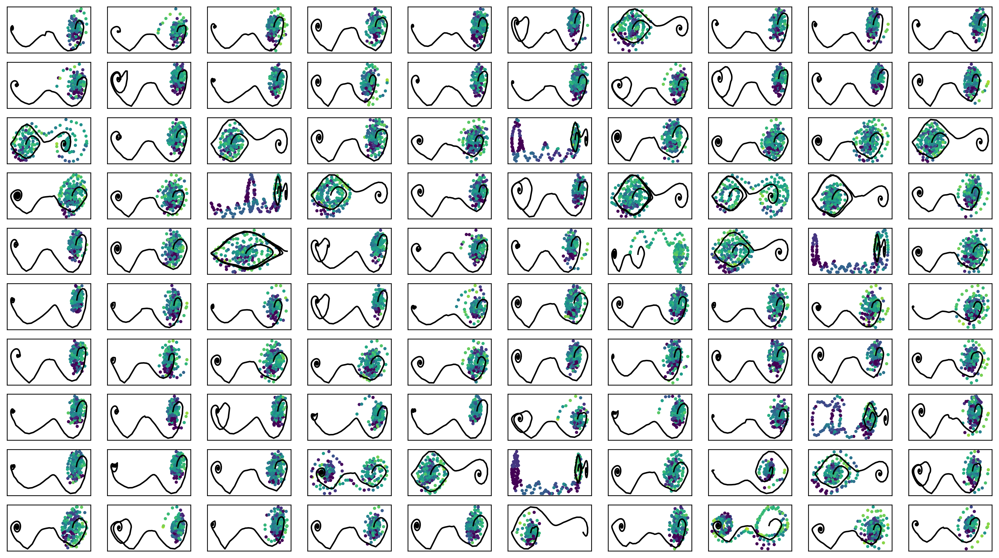

In [53]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter4.png")

In [54]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [55]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [56]:
# i = 35
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

In [57]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()

train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -582.73318  validloss -535.00737±0.00000  bestvalidloss -535.00737  last_update 0
train: iter 1  trainloss -579.59434  validloss -532.86618±0.00000  bestvalidloss -535.00737  last_update 1
train: iter 2  trainloss -590.46396  validloss -544.45618±0.00000  bestvalidloss -544.45618  last_update 0
train: iter 3  trainloss -589.10961  validloss -499.49528±0.00000  bestvalidloss -544.45618  last_update 1
train: iter 4  trainloss -591.91892  validloss -533.60370±0.00000  bestvalidloss -544.45618  last_update 2
train: iter 5  trainloss -559.89472  validloss -523.15056±0.00000  bestvalidloss -544.45618  last_update 3
train: iter 6  trainloss -578.26238  validloss -513.36243±0.00000  bestvalidloss -544.45618  last_update 4
train: iter 7  trainloss -584.48322  validloss -528.90359±0.00000  bestvalidloss -544.45618  last_update 5
train: iter 8  trainloss -571.29919  validloss -521.41255±0.00000  bestvalidloss -544.45618  last_u

train: iter 75  trainloss -591.03665  validloss -535.44425±0.00000  bestvalidloss -544.45618  last_update 73
train: iter 76  trainloss -581.76490  validloss -532.33512±0.00000  bestvalidloss -544.45618  last_update 74
train: iter 77  trainloss -584.21108  validloss -520.57435±0.00000  bestvalidloss -544.45618  last_update 75
train: iter 78  trainloss -575.58513  validloss -542.95584±0.00000  bestvalidloss -544.45618  last_update 76
train: iter 79  trainloss -579.36178  validloss -467.92569±0.00000  bestvalidloss -544.45618  last_update 77
train: iter 80  trainloss -584.45904  validloss -534.86778±0.00000  bestvalidloss -544.45618  last_update 78
train: iter 81  trainloss -580.55182  validloss -525.17737±0.00000  bestvalidloss -544.45618  last_update 79
train: iter 82  trainloss -583.28756  validloss -540.41556±0.00000  bestvalidloss -544.45618  last_update 80
train: iter 83  trainloss -591.61964  validloss -520.70618±0.00000  bestvalidloss -544.45618  last_update 81
train: iter 84  tra

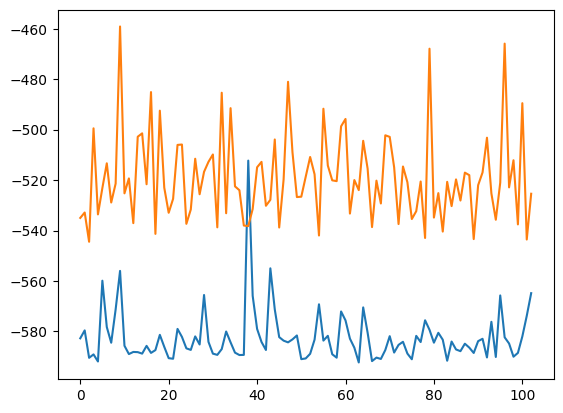

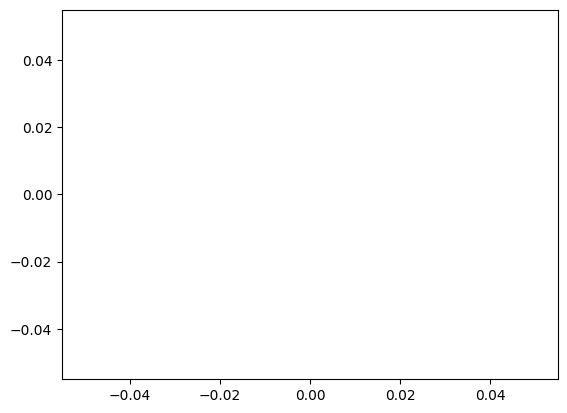

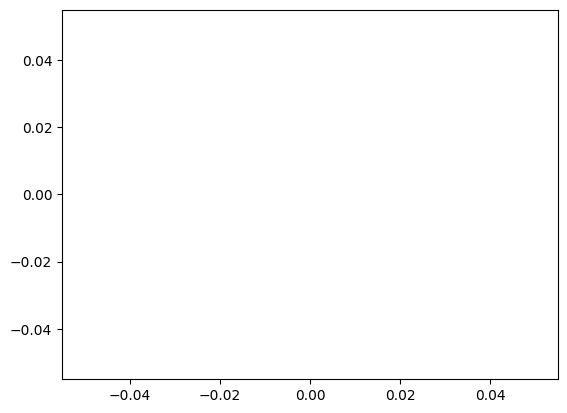

alpha 0.1 vae_lr 0.0005


In [58]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

plt.plot(train_curve2)
plt.plot(valid_curve2)
plt.show()

plt.plot(train_curve3)
plt.plot(valid_curve3)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)

In [59]:
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)




 0 7.152557373046875e-07

 1 3.3842101097106934

 2 3.1881532669067383

 3 3.124645948410034

 4 3.675438404083252

 5 3.1270551681518555

 6 3.0301010608673096

 7 3.347337484359741

 8 4.398653268814087

 9 3.7057552337646484

 10 3.7856643199920654

 11 4.619070529937744

 12 5.455482006072998

 13 3.430342435836792

 14 4.688547134399414

 15 4.58532977104187

 16 3.306168794631958

 17 3.383514165878296

 18 3.1195638179779053

 19 3.1854844093322754

 20 3.0889651775360107

 21 3.0455353260040283

 22 4.606755495071411

 23 3.534956216812134

 24 6.606560468673706

 25 5.930172920227051

 26 3.2114527225494385
predict diverge [  18.02946604 -623.48657982] sim_timestep 174

 27 2.777810573577881

 28 3.2197327613830566

 29 6.901715040206909

 30 6.097906112670898

 31 7.585643291473389

 32 6.971217155456543

 33 4.830386161804199

 34 3.764838695526123

 35 7.839905738830566

 36 7.461906433105469

 37 5.6267828941345215

 38 7.229847192764282

 39 5.7593255043029785

 40 4.441

実環境方策rollout vs Sim環境方策rollout


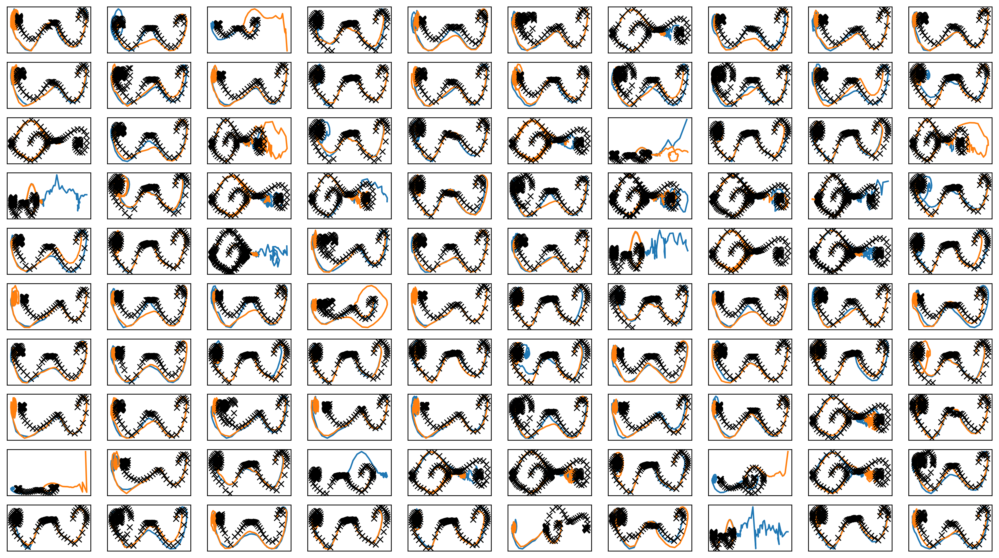

In [60]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter4.png")
plt.savefig(figfilenamehead+"joint_iter4.eps")
# plt.savefig(figfilenamehead+"joint_iter4.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

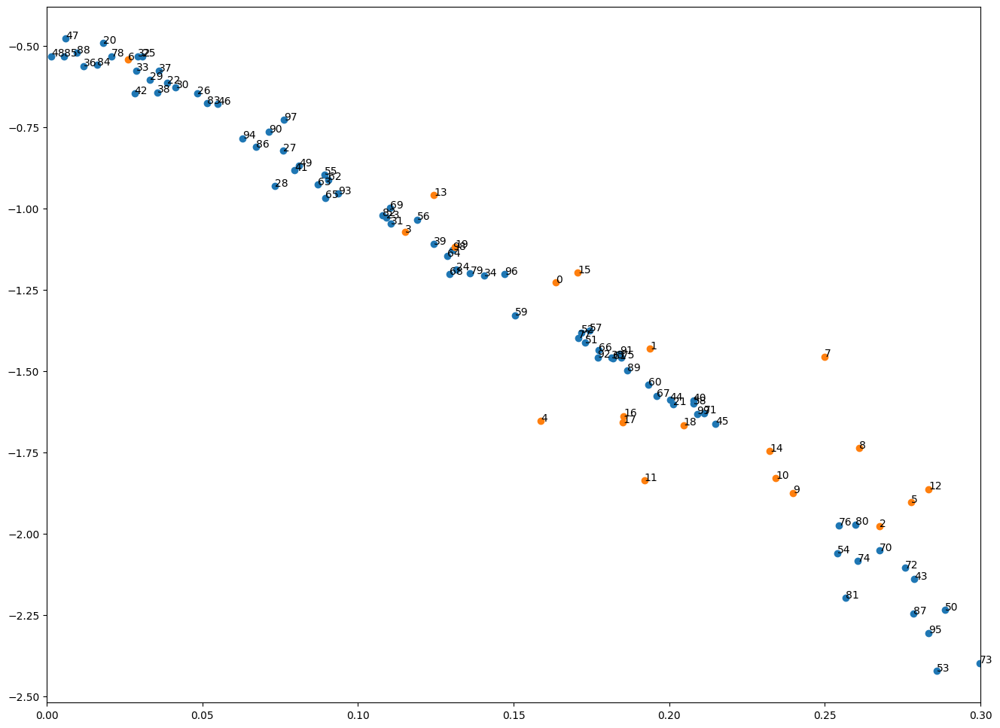

[0.16346495 0.19376823 0.2675319  0.11503246 0.15866848 0.27767899
 0.02613879 0.24978595 0.26100364 0.23974757]
[0.23415875 0.19197631 0.28340068 0.12439858 0.23227011 0.17053018
 0.18529065 0.1850802  0.20454609 0.13110959]
[0.01806764 0.20119136 0.03867789 0.10911323 0.13158045 0.03061344
 0.04839286 0.07598748 0.07332768 0.03311254]
[0.04145489 0.11061755 0.02913038 0.02882952 0.14059536 0.18145366
 0.01175634 0.03605897 0.03561832 0.1242789 ]
[0.20774164 0.07961685 0.02818215 0.27878886 0.20022311 0.21489816
 0.05495741 0.00603226 0.00140864 0.08100239]
[0.28865656 0.1728472  0.17167557 0.2858247  0.2539226  0.08923109
 0.11895172 0.17438186 0.20775948 0.15039731]
[0.19319706 0.18191796 0.09047245 0.08702328 0.12863061 0.0894847
 0.17726183 0.19596025 0.12942553 0.11026856]
[0.26757701 0.21116658 0.27584478 0.2996541  0.26043782 0.18466787
 0.25440247 0.17073022 0.0207501  0.1360628 ]
[0.2599147  0.256741   0.10799342 0.0514889  0.0163014  0.00555654
 0.06717741 0.27842439 0.00955

In [61]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter4.png")
plt.savefig(figfilenamehead+"damping_latent_iter4.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter4.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])

# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [62]:
print(datetime.datetime.now())

2023-05-10 16:54:37.271999


# Iter5

In [63]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0
predict diverge [   13.82832198 -9138.83000342] sim_timestep 35
predict diverge [5.41233026e+00 4.12093236e+07] sim_timestep 36
predict diverge [1.27519317e+01 7.04443203e+05] sim_timestep 37
predict diverge [2.05925737e+01 7.86892836e+08] sim_timestep 38
predict diverge [2.85171522e+01 5.94272645e+08] sim_timestep 39
predict diverge [3.64938724e+01 4.38218429e+08] sim_timestep 40

 1

 2
predict diverge [  10.6630598  -148.46752241] sim_timestep 64
predict diverge [ 2.30445371e+00 -8.18068834e+06] sim_timestep 65
predict diverge [-6.17033795e+00 -1.28580941e+04] sim_timestep 66
predict diverge [-1.53218023e+01 -8.62796105e+04] sim_timestep 67
predict diverge [-2.42514979e+01 -3.25240034e+05] sim_timestep 68
predict diverge [-3.32828118e+01 -1.61701903e+06] sim_timestep 69
predict diverge [-4.22455484e+01  7.34890188e+05] sim_timestep 70
predict diverge [-3.37614702e+01 -7.65188258e+06] sim_timestep 71
predict diverge [-4.26679263e+01 -6.60701720e+06] sim_timestep 72
predict diverg

predict diverge [ 1.95000104e+01 -3.31889155e+08] sim_timestep 41
predict diverge [1.09662674e+01 2.97317472e+08] sim_timestep 42
predict diverge [ 1.87199742e+01 -1.65295954e+08] sim_timestep 43
predict diverge [1.05677329e+01 1.96824571e+08] sim_timestep 44
predict diverge [ 1.83221824e+01 -2.97842906e+08] sim_timestep 45
predict diverge [ 9.91158741e+00 -2.96702079e+08] sim_timestep 46
predict diverge [ 1.51829907e+00 -5.75633320e+06] sim_timestep 47
predict diverge [-7.08531475e+00 -1.52977120e+04] sim_timestep 48
predict diverge [-1.64287655e+01  2.93439013e+04] sim_timestep 49
predict diverge [-8.06373913e+00  1.85439705e+04] sim_timestep 50
predict diverge [-3.00323684e-02  2.81853064e+06] sim_timestep 51
predict diverge [8.05486847e+00 3.84436360e+05] sim_timestep 52
predict diverge [1.56194878e+01 3.54946411e+07] sim_timestep 53
predict diverge [ 2.34342493e+01 -4.51459290e+08] sim_timestep 54
predict diverge [ 1.46930922e+01 -6.92267498e+07] sim_timestep 55
predict diverge [ 

predict diverge [1.09058993e+02 1.25129513e+08] sim_timestep 131
predict diverge [ 1.10232464e+02 -7.80094333e+06] sim_timestep 132
predict diverge [ 10168.97954956 526708.29985783] sim_timestep 133
predict diverge [1.09417107e+02 1.47564494e+07] sim_timestep 134
predict diverge [1.08111064e+02 1.05413254e+08] sim_timestep 135
predict diverge [1.08036181e+02 3.15152727e+08] sim_timestep 136
predict diverge [1.08181733e+02 1.31214750e+08] sim_timestep 137
predict diverge [ 1.05485225e+02 -3.00767649e+07] sim_timestep 138
predict diverge [-2.21605446e+03  2.66972956e+06] sim_timestep 139
predict diverge [-9.16107466e+01 -5.80152943e+05] sim_timestep 140
predict diverge [-1.00374931e+02  4.43518672e+05] sim_timestep 141
predict diverge [-9.15943931e+01 -8.86339855e+05] sim_timestep 142
predict diverge [-9.97532380e+01  3.22095738e+05] sim_timestep 143
predict diverge [-9.13232577e+01  2.85474319e+05] sim_timestep 144
predict diverge [-8.28966817e+01  6.21587289e+05] sim_timestep 145
predi

predict diverge [ 4.70538354e+01 -7.89731128e+08] sim_timestep 137
predict diverge [ 1.13992644e+01 -5.18650489e+08] sim_timestep 138
predict diverge [3.09368444e+00 5.56692262e+08] sim_timestep 139
predict diverge [ 1.08858388e+01 -2.56098973e+05] sim_timestep 140
predict diverge [2.60828025e+00 1.22916671e+08] sim_timestep 141
predict diverge [1.05230121e+01 5.07972787e+04] sim_timestep 142
predict diverge [ 1.83348267e+01 -1.68963481e+06] sim_timestep 143
predict diverge [1.08477401e+01 2.63345783e+09] sim_timestep 144
predict diverge [ 1.86303449e+01 -6.40516614e+08] sim_timestep 145
predict diverge [1.15457018e+01 3.16698845e+09] sim_timestep 146
predict diverge [1.94695844e+01 1.49834600e+09] sim_timestep 147
predict diverge [2.75216892e+01 9.99882322e+09] sim_timestep 148
predict diverge [ 3.55756256e+01 -1.60160505e+10] sim_timestep 149
predict diverge [3.10685523e+01 1.16189258e+09] sim_timestep 150
predict diverge [ 3.91834529e+01 -6.01544201e+08] sim_timestep 151
predict div

predict diverge [-9.15201149e+01 -2.50800058e+06] sim_timestep 80
predict diverge [-9.99819185e+01  9.52463309e+05] sim_timestep 81
predict diverge [-9.1501477e+01  2.4062272e+06] sim_timestep 82
predict diverge [-8.30017878e+01 -6.29375684e+05] sim_timestep 83
predict diverge [-9.14859429e+01  1.82901491e+06] sim_timestep 84
predict diverge [-8.29886016e+01  1.16882579e+05] sim_timestep 85
predict diverge [-7.44811337e+01  9.61603807e+05] sim_timestep 86
predict diverge [-6.59469296e+01  1.69271735e+06] sim_timestep 87
predict diverge [-5.75782825e+01 -2.78469106e+05] sim_timestep 88
predict diverge [-6.63368102e+01  8.41924640e+06] sim_timestep 89
predict diverge [-5.79786991e+01  8.16224241e+05] sim_timestep 90
predict diverge [-4.95674714e+01  2.44872067e+06] sim_timestep 91
predict diverge [-4.0964527e+01  6.6886502e+06] sim_timestep 92
predict diverge [-3.25225891e+01  7.46623472e+06] sim_timestep 93
predict diverge [-2.40636797e+01 -9.09269000e+06] sim_timestep 94
predict diverg

predict diverge [-8.29797371e+01  8.02162566e+05] sim_timestep 208
predict diverge [-7.44345446e+01 -1.29759906e+06] sim_timestep 209
predict diverge [-8.31711952e+01 -5.25783253e+06] sim_timestep 210
predict diverge [-9.17056357e+01  3.53672975e+05] sim_timestep 211
predict diverge [-8.31868022e+01 -5.71669233e+05] sim_timestep 212
predict diverge [-9.17365005e+01 -9.73249952e+05] sim_timestep 213
predict diverge [-1.00263668e+02  5.35581289e+06] sim_timestep 214
predict diverge [-9.15406465e+01  1.31788855e+06] sim_timestep 215
predict diverge [-8.30283040e+01  3.26972969e+05] sim_timestep 216
predict diverge [-7.44800673e+01  7.49727425e+05] sim_timestep 217
predict diverge [-6.59780944e+01  1.18566558e+06] sim_timestep 218
predict diverge [-5.76186697e+01  3.00446936e+05] sim_timestep 219
predict diverge [-4.91860309e+01  4.25162433e+05] sim_timestep 220
predict diverge [-4.07536892e+01  1.65798141e+06] sim_timestep 221
predict diverge [-3.22893233e+01 -6.44453193e+06] sim_timestep

predict diverge [-1.08394336e+02 -2.44385983e+06] sim_timestep 333
predict diverge [-1.08351432e+02  3.06537407e+05] sim_timestep 334
predict diverge [-9.15247941e+01  2.21873873e+06] sim_timestep 335
predict diverge [-8.30184412e+01 -7.20674589e+05] sim_timestep 336
predict diverge [-9.15603251e+01 -3.10297342e+06] sim_timestep 337
predict diverge [-1.00378039e+02 -2.91952535e+06] sim_timestep 338
predict diverge [-1.08399591e+02  1.55920470e+05] sim_timestep 339
predict diverge [-9.15240968e+01  4.46502027e+05] sim_timestep 340
predict diverge [   -83.0278991  -82217.25825819] sim_timestep 341
predict diverge [-9.18485691e+01 -5.51821948e+06] sim_timestep 342
predict diverge [-1.00302961e+02  4.49326943e+06] sim_timestep 343
predict diverge [-9.15006935e+01 -5.28304397e+05] sim_timestep 344
predict diverge [-1.00373641e+02 -2.83111611e+06] sim_timestep 345
predict diverge [-1.08615592e+02 -5.79432714e+05] sim_timestep 346
predict diverge [-1.08679768e+02 -1.06795568e+06] sim_timestep

predict diverge [1.57936936e+01 1.17089352e+08] sim_timestep 40
predict diverge [ 2.35323902e+01 -2.54204966e+07] sim_timestep 41
predict diverge [ 1.47064238e+01 -8.73892227e+07] sim_timestep 42
predict diverge [ 6.32640891e+00 -2.15422352e+08] sim_timestep 43
predict diverge [-2.35758524e+00  1.04684834e+05] sim_timestep 44
predict diverge [5.5993980e+00 5.7010308e+05] sim_timestep 45
predict diverge [1.29343999e+01 3.81717746e+05] sim_timestep 46
predict diverge [2.06760404e+01 1.97300525e+07] sim_timestep 47
predict diverge [2.84020034e+01 1.86243787e+07] sim_timestep 48
predict diverge [3.61799679e+01 4.15657104e+07] sim_timestep 49
predict diverge [4.40055789e+01 4.71139355e+07] sim_timestep 50
predict diverge [ 5.20798985e+01 -1.47196758e+07] sim_timestep 51
predict diverge [ 4.09361374e+01 -1.23381273e+07] sim_timestep 52
predict diverge [ 3.49869038e+01 -4.64661575e+06] sim_timestep 53
predict diverge [2.52478612e+01 5.22374378e+07] sim_timestep 54
predict diverge [ 3.30079397

predict diverge [-2.23761124e+01  5.84627094e+05] sim_timestep 68
predict diverge [-1.40446939e+01 -1.41806381e+06] sim_timestep 69
predict diverge [-2.31995079e+01 -3.39660809e+05] sim_timestep 70
predict diverge [-3.23716093e+01  3.28979245e+06] sim_timestep 71
predict diverge [-2.40663977e+01 -5.89128401e+06] sim_timestep 72
predict diverge [-3.32268345e+01  3.86104433e+06] sim_timestep 73
predict diverge [-2.48711909e+01  3.65788037e+04] sim_timestep 74
predict diverge [-1.65632564e+01  6.89692675e+06] sim_timestep 75
predict diverge [-8.15397305e+00 -3.28043418e+06] sim_timestep 76
predict diverge [-1.75279379e+01  2.59578196e+05] sim_timestep 77
predict diverge [-9.09892779e+00  3.36508969e+06] sim_timestep 78
predict diverge [-1.05190275e+00  8.43619428e+05] sim_timestep 79
predict diverge [ 7.00366757e+00 -9.00834135e+05] sim_timestep 80
predict diverge [-1.67578034e+00  8.26583564e+04] sim_timestep 81
predict diverge [ 6.31819305e+00 -4.96535262e+05] sim_timestep 82
predict di

predict diverge [  13.34862461 3526.14714397] sim_timestep 51
predict diverge [ 2.11582165e+01 -5.81303303e+08] sim_timestep 52
predict diverge [ 1.24788089e+01 -6.68434271e+07] sim_timestep 53
predict diverge [ 4.29450536e+00 -1.36540751e+08] sim_timestep 54
predict diverge [-4.47566952e+00  2.76540672e+04] sim_timestep 55
predict diverge [ 3.41481643e+00 -8.08974641e+05] sim_timestep 56
predict diverge [-5.31447370e+00  1.46334346e+04] sim_timestep 57
predict diverge [ 2.62996210e+00 -2.18428419e+06] sim_timestep 58
predict diverge [-6.00965928e+00  2.73512682e+04] sim_timestep 59
predict diverge [ 1.95195347e+00 -5.48157104e+04] sim_timestep 60
predict diverge [-6.73152740e+00 -9.52698082e+03] sim_timestep 61
predict diverge [-1.60996091e+01 -5.93379794e+05] sim_timestep 62
predict diverge [-2.53613581e+01  3.71666088e+05] sim_timestep 63
predict diverge [-1.70470691e+01  2.59578979e+06] sim_timestep 64
predict diverge [-8.63313546e+00 -1.05559462e+07] sim_timestep 65
predict diverg

predict diverge [-1.00085964e+02  1.23985749e+06] sim_timestep 92
predict diverge [-9.15756793e+01  4.08878524e+05] sim_timestep 93
predict diverge [-8.31091788e+01 -5.52738657e+05] sim_timestep 94
predict diverge [-9.15976538e+01 -8.41987956e+06] sim_timestep 95
predict diverge [-1.00176459e+02 -2.72108833e+06] sim_timestep 96
predict diverge [-1.08606914e+02 -8.59638437e+05] sim_timestep 97
predict diverge [-1.08466812e+02  9.90295514e+05] sim_timestep 98
predict diverge [-9.15679481e+01  7.23900961e+05] sim_timestep 99
predict diverge [-8.31168207e+01  4.45657153e+05] sim_timestep 100
predict diverge [-7.46523981e+01  5.71553909e+05] sim_timestep 101
predict diverge [-6.61749827e+01 -1.07532123e+06] sim_timestep 102
predict diverge [-7.48146270e+01 -8.45690433e+06] sim_timestep 103
predict diverge [-8.35047244e+01  4.76456059e+06] sim_timestep 104
predict diverge [-7.50054504e+01 -6.03770801e+05] sim_timestep 105
predict diverge [-8.37483450e+01 -4.43142867e+06] sim_timestep 106
pre

predict diverge [3.44212247e+00 2.47230836e+06] sim_timestep 50
predict diverge [1.11172373e+01 6.62097720e+05] sim_timestep 51
predict diverge [1.89315497e+01 5.95503346e+08] sim_timestep 52
predict diverge [ 2.70163674e+01 -1.14817047e+10] sim_timestep 53
predict diverge [2.06469015e+01 1.16317372e+10] sim_timestep 54
predict diverge [ 2.87627332e+01 -1.41424366e+08] sim_timestep 55
predict diverge [ 1.97485252e+01 -6.56564518e+09] sim_timestep 56
predict diverge [ 1.42330693e+01 -2.07315459e+10] sim_timestep 57
predict diverge [5.87341549e+00 4.71961493e+09] sim_timestep 58
predict diverge [1.32094263e+01 5.55880335e+05] sim_timestep 59
predict diverge [2.12032085e+01 1.72215895e+09] sim_timestep 60
predict diverge [ 2.93586342e+01 -8.64631813e+08] sim_timestep 61
predict diverge [ 2.21305208e+01 -5.86604725e+08] sim_timestep 62
predict diverge [1.53238107e+01 4.51132676e+08] sim_timestep 63
predict diverge [ 2.33797207e+01 -7.34847422e+09] sim_timestep 64
predict diverge [ 1.442629

predict diverge [1.30222211e+01 8.38904164e+09] sim_timestep 30
predict diverge [2.10278745e+01 5.83989468e+09] sim_timestep 31
predict diverge [2.91750570e+01 1.35091629e+10] sim_timestep 32
predict diverge [ 3.73495581e+01 -3.46150132e+09] sim_timestep 33
predict diverge [ 2.59629413e+01 -9.24370099e+09] sim_timestep 34
predict diverge [2.05057876e+01 2.80944279e+09] sim_timestep 35
predict diverge [2.85951429e+01 4.49198227e+08] sim_timestep 36
predict diverge [3.67447072e+01 1.29636528e+10] sim_timestep 37
predict diverge [ 4.49314619e+01 -8.59597114e+09] sim_timestep 38
predict diverge [1.15873989e+02 1.06862934e+09] sim_timestep 39
predict diverge [ 1.10774831e+02 -4.97513489e+08] sim_timestep 40
predict diverge [-3.81216302e+02  1.51226938e+06] sim_timestep 41
predict diverge [-9.15822427e+01 -4.11145388e+05] sim_timestep 42
predict diverge [-1.00205249e+02  2.51154038e+06] sim_timestep 43

 45
predict diverge [ 11.42518226 124.50645654] sim_timestep 46
predict diverge [1.929945

predict diverge [  -11.76631751 -7778.42896583] sim_timestep 55
predict diverge [-2.09918451e+01  2.52089067e+05] sim_timestep 56
predict diverge [-1.25468205e+01  1.23048563e+06] sim_timestep 57
predict diverge [-4.30153664e+00  7.86671784e+06] sim_timestep 58
predict diverge [ 3.65800467e+00 -1.72564411e+06] sim_timestep 59
predict diverge [ -5.03859881 751.9926354 ] sim_timestep 60
predict diverge [2.86475649e+00 6.55469173e+05] sim_timestep 61
predict diverge [ 1.07011350e+01 -1.72493043e+05] sim_timestep 62
predict diverge [ 2.40647481e+00 -1.10240013e+08] sim_timestep 63
predict diverge [-6.18435132e+00 -2.21393809e+04] sim_timestep 64
predict diverge [-1.53925862e+01  1.07318211e+05] sim_timestep 65
predict diverge [-6.97952822e+00  6.33392819e+06] sim_timestep 66
predict diverge [1.02206092e+00 1.20367188e+05] sim_timestep 67
predict diverge [9.20746198e+00 1.96477222e+04] sim_timestep 68
predict diverge [ 1.69148193e+01 -1.73020592e+08] sim_timestep 69
predict diverge [ 8.6342


 59
predict diverge [  10.75802514 1420.84440081] sim_timestep 34
predict diverge [ 1.85786039e+01 -1.99325202e+07] sim_timestep 35
predict diverge [ 9.92625351e+00 -1.09486131e+09] sim_timestep 36
predict diverge [1.5245911e+00 1.7885079e+08] sim_timestep 37
predict diverge [ 9.66063904e+00 -5.83759852e+04] sim_timestep 38
predict diverge [1.21747140e+00 3.17800806e+07] sim_timestep 39
predict diverge [9.37446627e+00 4.20804495e+05] sim_timestep 40
predict diverge [ 1.70784693e+01 -8.19291734e+07] sim_timestep 41
predict diverge [8.97426439e+00 1.94717600e+09] sim_timestep 42
predict diverge [ 1.66340487e+01 -1.89662866e+08] sim_timestep 43
predict diverge [8.49205885e+00 7.96363725e+08] sim_timestep 44
predict diverge [ 1.60894413e+01 -4.43149363e+06] sim_timestep 45
predict diverge [8.08915368e+00 4.83629008e+08] sim_timestep 46
predict diverge [ 1.56647207e+01 -3.48167020e+06] sim_timestep 47
predict diverge [ 7.87600408e+00 -7.25867305e+08] sim_timestep 48
predict diverge [-7.003

predict diverge [  -80.99665126 30186.56703788] sim_timestep 62
predict diverge [-7.25099514e+01 -8.64602144e+05] sim_timestep 63
predict diverge [-8.13619999e+01 -1.19306750e+07] sim_timestep 64
predict diverge [-9.01071296e+01  2.75445219e+06] sim_timestep 65
predict diverge [-8.16507599e+01 -1.15061953e+06] sim_timestep 66
predict diverge [-9.07373236e+01  1.81673351e+06] sim_timestep 67
predict diverge [-8.22803505e+01  1.00263558e+06] sim_timestep 68
predict diverge [   -73.78861018 -73529.13126639] sim_timestep 69
predict diverge [-8.25950226e+01  2.12455769e+06] sim_timestep 70
predict diverge [-7.41223294e+01  4.04015761e+05] sim_timestep 71
predict diverge [-6.56917453e+01 -1.66145929e+05] sim_timestep 72
predict diverge [-7.42161319e+01 -1.28932728e+07] sim_timestep 73
predict diverge [-8.28605080e+01 -8.05353706e+05] sim_timestep 74
predict diverge [-9.14887268e+01  8.15461155e+05] sim_timestep 75
predict diverge [-8.30246489e+01  1.43685714e+06] sim_timestep 76
predict dive


 64
predict diverge [7.37480966e+00 1.21556300e+04] sim_timestep 76
predict diverge [ 1.48490133e+01 -2.62592629e+06] sim_timestep 77
predict diverge [6.50513128e+00 5.33089812e+08] sim_timestep 78
predict diverge [ 1.39264228e+01 -2.07828101e+06] sim_timestep 79
predict diverge [ 5.70978913e+00 -2.05023769e+08] sim_timestep 80
predict diverge [-3.01331787e+00 -6.99757790e+05] sim_timestep 81
predict diverge [-1.20433566e+01  8.52918922e+04] sim_timestep 82
predict diverge [-3.84907265e+00  4.19662995e+06] sim_timestep 83
predict diverge [ 4.06713275e+00 -5.21904802e+05] sim_timestep 84
predict diverge [-4.69267551e+00 -3.24478733e+04] sim_timestep 85
predict diverge [-1.39040882e+01  1.23174380e+05] sim_timestep 86
predict diverge [-5.60483328e+00  3.94755386e+06] sim_timestep 87
predict diverge [2.34151455e+00 3.36071437e+05] sim_timestep 88
predict diverge [1.03227361e+01 2.32756589e+04] sim_timestep 89
predict diverge [1.80625350e+01 1.73378015e+08] sim_timestep 90
predict diverge

predict diverge [-2.54141842e+01  6.92488867e+05] sim_timestep 121
predict diverge [-1.69838128e+01  1.50460210e+07] sim_timestep 122
predict diverge [-8.47480460e+00  1.77109093e+07] sim_timestep 123
predict diverge [-4.10076752e-01  1.03319577e+06] sim_timestep 124
predict diverge [    7.76699545 -3976.99358564] sim_timestep 125
predict diverge [-8.30123284e-01  6.44102742e+06] sim_timestep 126
predict diverge [ 7.32560663e+00 -6.65924526e+05] sim_timestep 127
predict diverge [-1.29809237e+00  3.21807437e+06] sim_timestep 128
predict diverge [ 6.79318178e+00 -2.14169208e+05] sim_timestep 129
predict diverge [-1.90763277e+00  1.37846377e+06] sim_timestep 130
predict diverge [ 6.15778282e+00 -7.77569685e+05] sim_timestep 131
predict diverge [-2.54821196e+00 -2.24386737e+05] sim_timestep 132
predict diverge [1.88299303e+01 8.95801179e+07] sim_timestep 50
predict diverge [2.69099092e+01 1.07031024e+10] sim_timestep 51
predict diverge [ 3.50392889e+01 -3.17143516e+10] sim_timestep 52
pred

predict diverge [-1.26984127e+01 -1.78829566e+06] sim_timestep 99
predict diverge [-2.18111890e+01  8.09220061e+05] sim_timestep 100
predict diverge [-1.34609583e+01  7.15637296e+06] sim_timestep 101
predict diverge [-5.16167061e+00  6.80519906e+06] sim_timestep 102
predict diverge [ 2.75759568e+00 -2.44685732e+06] sim_timestep 103
predict diverge [-5.95707520e+00 -4.25056737e+04] sim_timestep 104
predict diverge [-1.52255148e+01 -7.50406344e+04] sim_timestep 105
predict diverge [-2.43929581e+01 -5.25621246e+05] sim_timestep 106
predict diverge [-3.36733342e+01 -4.88164191e+06] sim_timestep 107
predict diverge [-4.28676423e+01  7.40256847e+06] sim_timestep 108
predict diverge [-3.45882302e+01  1.26379622e+06] sim_timestep 109
predict diverge [-2.62627035e+01 -5.78447906e+06] sim_timestep 110
predict diverge [-3.55608637e+01  5.56235103e+06] sim_timestep 111
predict diverge [-2.72231257e+01 -2.74597587e+05] sim_timestep 112
predict diverge [-3.64763169e+01  5.95247056e+06] sim_timestep 

predict diverge [1.21769006e+01 3.27903940e+05] sim_timestep 36
predict diverge [ 1.97968034e+01 -9.53611881e+07] sim_timestep 37
predict diverge [1.12844704e+01 3.03896348e+06] sim_timestep 38
predict diverge [1.89379059e+01 5.13408392e+07] sim_timestep 39
predict diverge [2.65911558e+01 2.71623354e+06] sim_timestep 40
predict diverge [3.42762671e+01 2.66671674e+07] sim_timestep 41
predict diverge [4.20197547e+01 3.91769209e+07] sim_timestep 42
predict diverge [ 4.97946118e+01 -2.98815944e+07] sim_timestep 43
predict diverge [ 4.53247211e+01 -5.63354978e+06] sim_timestep 44
predict diverge [ 3.58359139e+01 -2.29508518e+06] sim_timestep 45
predict diverge [2.62755554e+01 1.10143464e+07] sim_timestep 46
predict diverge [ 3.39564500e+01 -2.24211588e+07] sim_timestep 47
predict diverge [2.56279839e+01 2.20884046e+07] sim_timestep 48
predict diverge [3.33070884e+01 7.78412228e+07] sim_timestep 49
predict diverge [ 4.10590441e+01 -9.13195572e+07] sim_timestep 50
predict diverge [3.48277557e

predict diverge [-5.26414227e+01 -1.26291710e+07] sim_timestep 151
predict diverge [-6.15238980e+01 -1.94999986e+07] sim_timestep 152
predict diverge [-7.04021934e+01 -1.13398344e+06] sim_timestep 153
predict diverge [-7.92922927e+01  1.69035765e+07] sim_timestep 154
predict diverge [-7.08372636e+01  1.79919409e+05] sim_timestep 155
predict diverge [   -62.59544623 -37375.50044344] sim_timestep 156
predict diverge [-7.13525102e+01  1.43711454e+07] sim_timestep 157
predict diverge [-6.30610226e+01 -2.33749520e+05] sim_timestep 158
predict diverge [-7.18111676e+01  2.05537844e+07] sim_timestep 159
predict diverge [-6.35520542e+01 -3.55051155e+05] sim_timestep 160
predict diverge [-7.19463612e+01 -2.01511888e+06] sim_timestep 161
predict diverge [-8.05742805e+01  1.26489145e+07] sim_timestep 162
predict diverge [-7.21008012e+01  8.62172100e+05] sim_timestep 163
predict diverge [-6.38091692e+01  1.82959674e+05] sim_timestep 164
predict diverge [-5.54854866e+01  1.02646284e+06] sim_timestep

predict diverge [-2.60398899e+01  1.66231340e+06] sim_timestep 67
predict diverge [-1.76482927e+01 -1.44878131e+06] sim_timestep 68
predict diverge [-2.67845020e+01  1.27068896e+06] sim_timestep 69
predict diverge [-1.83924899e+01 -4.52127079e+06] sim_timestep 70
predict diverge [-2.75392337e+01  9.38020808e+05] sim_timestep 71
predict diverge [-1.91539897e+01  1.57216266e+06] sim_timestep 72
predict diverge [-1.07028149e+01 -5.50001562e+06] sim_timestep 73
predict diverge [-1.99781697e+01  7.38221253e+04] sim_timestep 74
predict diverge [-1.15092426e+01  5.60324597e+06] sim_timestep 75
predict diverge [-3.34653881e+00  4.98116471e+06] sim_timestep 76
predict diverge [4.60313846e+00 8.24018012e+05] sim_timestep 77
predict diverge [1.19753596e+01 2.94103488e+05] sim_timestep 78
predict diverge [1.98671998e+01 1.83680007e+09] sim_timestep 79
predict diverge [ 2.79185219e+01 -3.71400690e+09] sim_timestep 80
predict diverge [ 1.97461138e+01 -1.48071421e+09] sim_timestep 81
predict diverge 


 99
 


In [64]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
# iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.26460  validloss 0.21772±0.00000  bestvalidloss 0.21772  last_update 0
train: iter 1  trainloss 0.25390  validloss 0.20730±0.00000  bestvalidloss 0.20730  last_update 0
train: iter 2  trainloss 0.25254  validloss 0.20718±0.00000  bestvalidloss 0.20718  last_update 0
train: iter 3  trainloss 0.25204  validloss 0.20224±0.00000  bestvalidloss 0.20224  last_update 0
train: iter 4  trainloss 0.25039  validloss 0.20470±0.00000  bestvalidloss 0.20224  last_update 1
train: iter 5  trainloss 0.25212  validloss 0.20113±0.00000  bestvalidloss 0.20113  last_update 0
train: iter 6  trainloss 0.25087  validloss 0.20383±0.00000  bestvalidloss 0.20113  last_update 1
train: iter 7  trainloss 0.25030  validloss 0.20184±0.00000  bestvalidloss 0.20113  last_update 2
train: iter 8  trainloss 0.24694  validloss 0.20321±0.00000  bestvalidloss 0.20113  last_update 3
train: iter 9  trainloss 0.25178  validloss 0.20331±0.00000  bestvalidloss 0.20113  last_update 4
train: iter 10  trai

train: iter 83  trainloss 0.23892  validloss 0.19875±0.00000  bestvalidloss 0.19534  last_update 27
train: iter 84  trainloss 0.23734  validloss 0.19740±0.00000  bestvalidloss 0.19534  last_update 28
train: iter 85  trainloss 0.23562  validloss 0.20500±0.00000  bestvalidloss 0.19534  last_update 29
train: iter 86  trainloss 0.23541  validloss 0.20376±0.00000  bestvalidloss 0.19534  last_update 30
train: iter 87  trainloss 0.23566  validloss 0.20099±0.00000  bestvalidloss 0.19534  last_update 31
train: iter 88  trainloss 0.23542  validloss 0.20199±0.00000  bestvalidloss 0.19534  last_update 32
train: iter 89  trainloss 0.23498  validloss 0.20627±0.00000  bestvalidloss 0.19534  last_update 33
train: iter 90  trainloss 0.23711  validloss 0.19935±0.00000  bestvalidloss 0.19534  last_update 34
train: iter 91  trainloss 0.23459  validloss 0.20173±0.00000  bestvalidloss 0.19534  last_update 35
train: iter 92  trainloss 0.23677  validloss 0.19884±0.00000  bestvalidloss 0.19534  last_update 36


([0.2646038027480245,
  0.2538972571492195,
  0.2525436721742153,
  0.2520392041653395,
  0.2503921673633158,
  0.25211853021755815,
  0.2508748576976359,
  0.25030075581744315,
  0.24693880481645464,
  0.2517779559828341,
  0.24863518886268138,
  0.24778238739818334,
  0.2476309877820313,
  0.24832987757399677,
  0.2465059864334762,
  0.2444542390294373,
  0.2449845677241683,
  0.24535862188786267,
  0.25368883963674305,
  0.2460712341591716,
  0.2450700920075178,
  0.2454542178660631,
  0.24382789358496665,
  0.243374284170568,
  0.24185883961617946,
  0.24426563829183578,
  0.24497314812615514,
  0.24272112613543867,
  0.24237309973686932,
  0.2447962759062648,
  0.24413848910480737,
  0.2426563048735261,
  0.24116992615163327,
  0.24313742239028216,
  0.2417310389690101,
  0.24067892748862504,
  0.244181674066931,
  0.24319358617067338,
  0.24202902698889375,
  0.23957231575623156,
  0.2416052627377212,
  0.24141851253807545,
  0.2415876760147512,
  0.23938680766150355,
  0.2406734

In [65]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -301.5966515171528
valid_loss:  -139.74303793907163
train_loss:  -580.64337184906
valid_loss:  -517.0958025741577


1e-08 1000.0


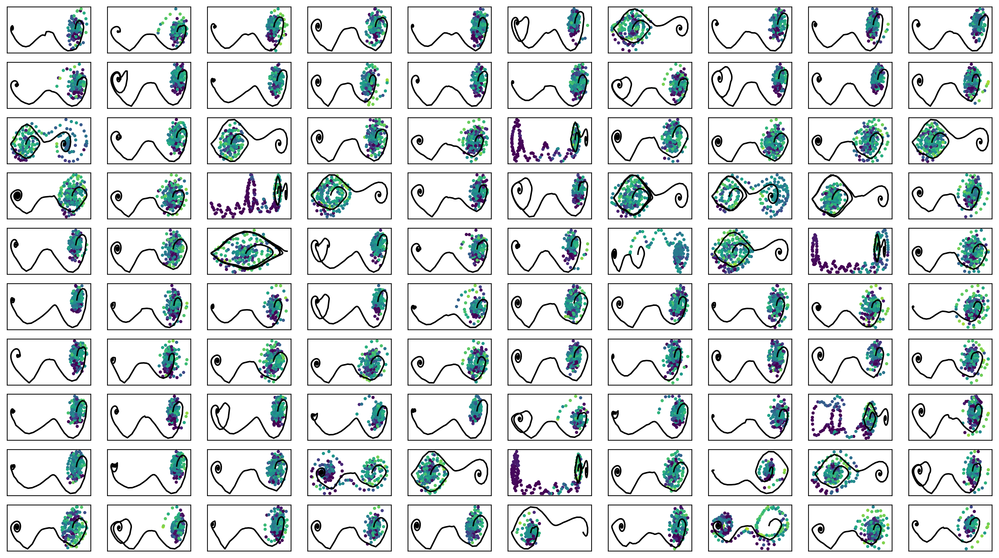

In [66]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter5.png")

In [67]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [68]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [69]:
train_curve1, valid_curve1 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()

train_curve2, valid_curve2 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()

train_curve3, valid_curve3 = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()

weight_alpha 0.1
train_weighted_vae: enc_dec
train: iter 0  trainloss -569.58132  validloss -521.38195±0.00000  bestvalidloss -521.38195  last_update 0
train: iter 1  trainloss -579.74473  validloss -496.33556±0.00000  bestvalidloss -521.38195  last_update 1
train: iter 2  trainloss -573.29995  validloss -520.45331±0.00000  bestvalidloss -521.38195  last_update 2
train: iter 3  trainloss -575.17026  validloss -534.21095±0.00000  bestvalidloss -534.21095  last_update 0
train: iter 4  trainloss -575.54401  validloss -528.16294±0.00000  bestvalidloss -534.21095  last_update 1
train: iter 5  trainloss -580.71150  validloss -529.51441±0.00000  bestvalidloss -534.21095  last_update 2
train: iter 6  trainloss -566.17909  validloss -527.63074±0.00000  bestvalidloss -534.21095  last_update 3
train: iter 7  trainloss -571.18376  validloss -490.97964±0.00000  bestvalidloss -534.21095  last_update 4
train: iter 8  trainloss -575.75054  validloss -516.84516±0.00000  bestvalidloss -534.21095  last_u

train: iter 76  trainloss -574.70977  validloss -512.21402±0.00000  bestvalidloss -539.74568  last_update 25
train: iter 77  trainloss -573.18264  validloss -497.03296±0.00000  bestvalidloss -539.74568  last_update 26
train: iter 78  trainloss -582.73707  validloss -519.21734±0.00000  bestvalidloss -539.74568  last_update 27
train: iter 79  trainloss -578.09349  validloss -517.06917±0.00000  bestvalidloss -539.74568  last_update 28
train: iter 80  trainloss -585.95600  validloss -516.15515±0.00000  bestvalidloss -539.74568  last_update 29
train: iter 81  trainloss -581.36772  validloss -499.03546±0.00000  bestvalidloss -539.74568  last_update 30
train: iter 82  trainloss -585.45060  validloss -510.19701±0.00000  bestvalidloss -539.74568  last_update 31
train: iter 83  trainloss -578.21567  validloss -483.24807±0.00000  bestvalidloss -539.74568  last_update 32
train: iter 84  trainloss -570.20972  validloss -527.62005±0.00000  bestvalidloss -539.74568  last_update 33
train: iter 85  tra

train: iter 151  trainloss -575.52507  validloss -500.52491±0.00000  bestvalidloss -539.74568  last_update 100
train: fin
weight_alpha 0.1
weight_alpha 0.1


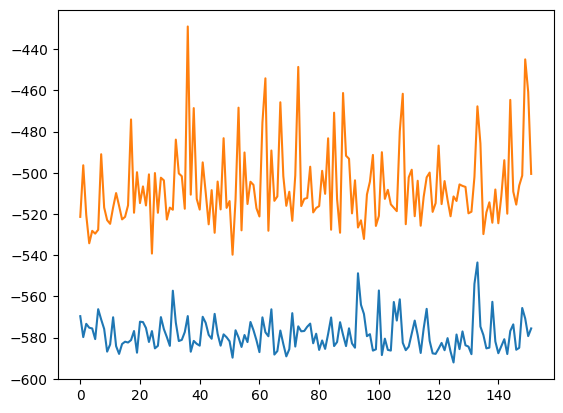

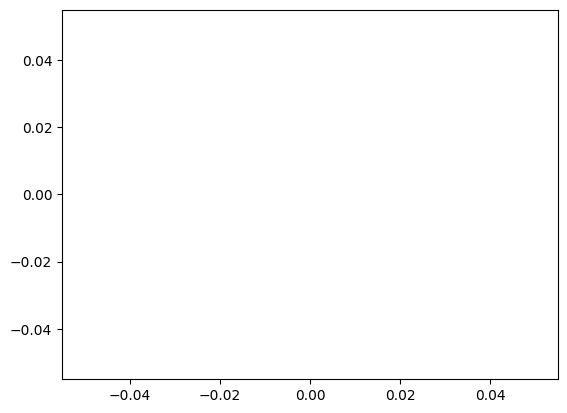

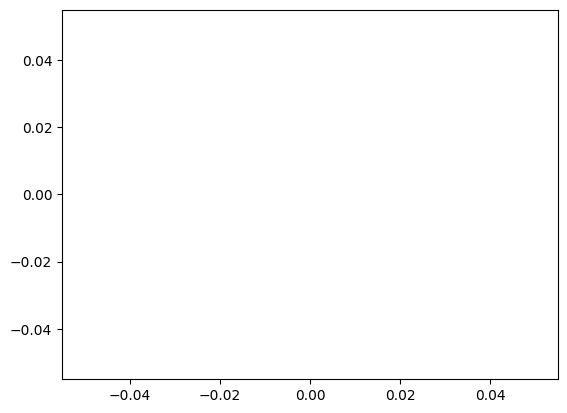

alpha 0.1 vae_lr 0.0005


In [70]:
plt.plot(train_curve1)
plt.plot(valid_curve1)
plt.show()

plt.plot(train_curve2)
plt.plot(valid_curve2)
plt.show()

plt.plot(train_curve3)
plt.plot(valid_curve3)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)

In [71]:
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_bamdppolicy_data_fixlen()
# simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)




 0 1.430511474609375e-06

 1 10.687687158584595

 2 10.350449562072754

 3 7.957001686096191

 4 9.969197750091553

 5 5.651905059814453

 6 9.052680492401123

 7 9.231784105300903

 8 11.599243402481079

 9 9.10230278968811

 10 9.40134882926941

 11 11.883558750152588

 12 7.448970556259155

 13 10.743825674057007

 14 10.68949270248413

 15 10.548621416091919

 16 11.06144118309021

 17 7.163639545440674

 18 3.571899890899658

 19 3.646111249923706

 20 5.4083709716796875

 21 5.3965373039245605

 22 3.315068006515503

 23 3.251598834991455

 24 4.844688892364502

 25 7.525688648223877

 26 7.002946376800537

 27 5.813458204269409

 28 3.4327268600463867

 29 5.1723408699035645

 30 3.9266676902770996

 31 5.908033609390259

 32 5.645267486572266

 33 6.1412599086761475

 34 8.939028024673462

 35 7.596561431884766

 36 8.072077989578247

 37 9.100902557373047

 38 10.96960711479187

 39 6.236846208572388

 40 3.6163976192474365

 41 5.773488521575928

 42 6.7568182945251465

 43 

実環境方策rollout vs Sim環境方策rollout


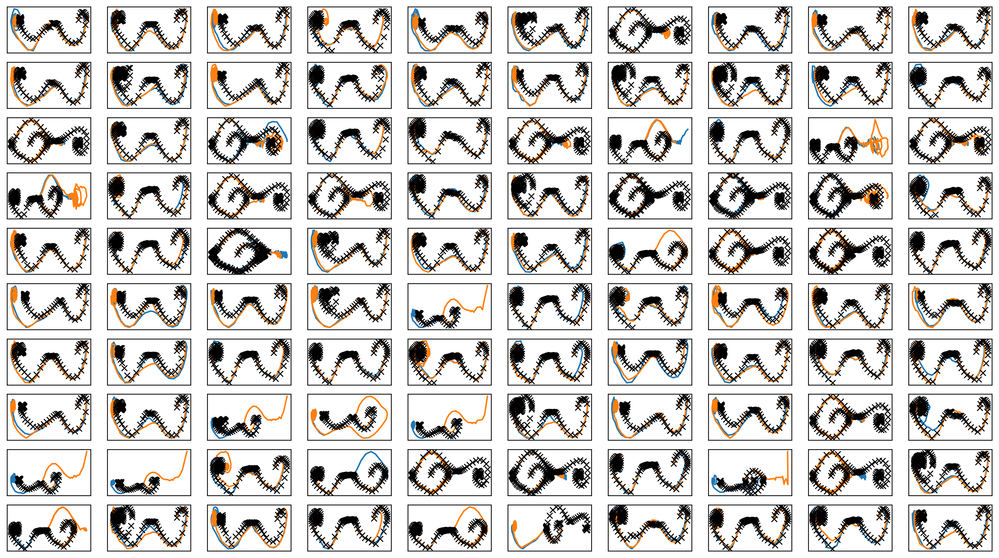

In [72]:
fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
#     ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig(figfilenamehead+"joint_iter5.png")
plt.savefig(figfilenamehead+"joint_iter5.eps")
# plt.savefig(figfilenamehead+"joint_iter5.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

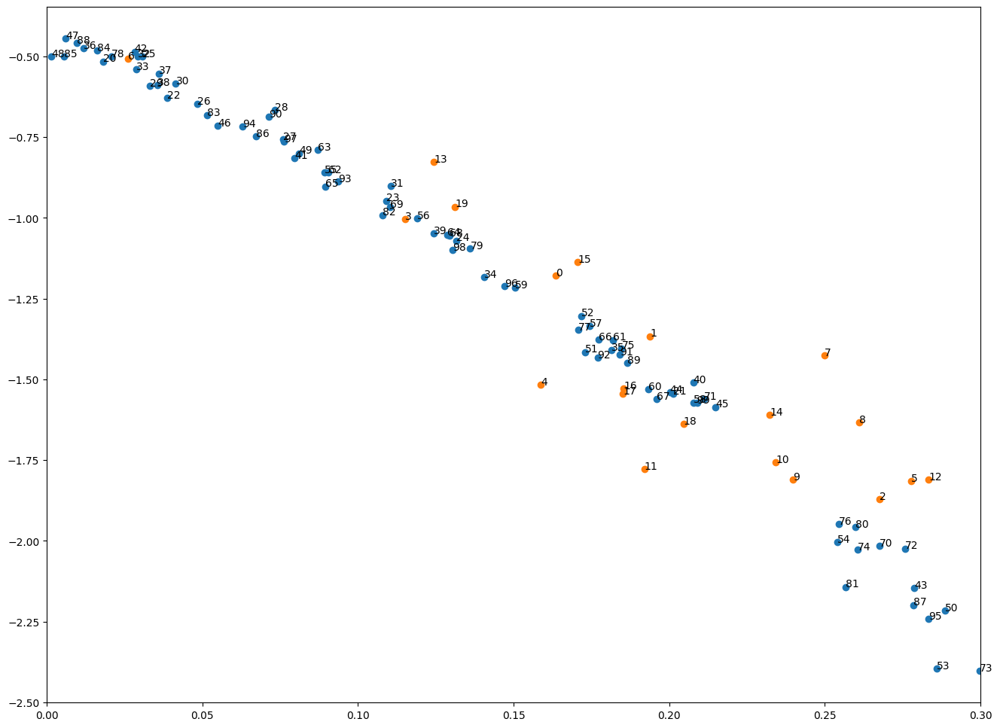

[0.16346495 0.19376823 0.2675319  0.11503246 0.15866848 0.27767899
 0.02613879 0.24978595 0.26100364 0.23974757]
[0.23415875 0.19197631 0.28340068 0.12439858 0.23227011 0.17053018
 0.18529065 0.1850802  0.20454609 0.13110959]
[0.01806764 0.20119136 0.03867789 0.10911323 0.13158045 0.03061344
 0.04839286 0.07598748 0.07332768 0.03311254]
[0.04145489 0.11061755 0.02913038 0.02882952 0.14059536 0.18145366
 0.01175634 0.03605897 0.03561832 0.1242789 ]
[0.20774164 0.07961685 0.02818215 0.27878886 0.20022311 0.21489816
 0.05495741 0.00603226 0.00140864 0.08100239]
[0.28865656 0.1728472  0.17167557 0.2858247  0.2539226  0.08923109
 0.11895172 0.17438186 0.20775948 0.15039731]
[0.19319706 0.18191796 0.09047245 0.08702328 0.12863061 0.0894847
 0.17726183 0.19596025 0.12942553 0.11026856]
[0.26757701 0.21116658 0.27584478 0.2996541  0.26043782 0.18466787
 0.25440247 0.17073022 0.0207501  0.1360628 ]
[0.2599147  0.256741   0.10799342 0.0514889  0.0163014  0.00555654
 0.06717741 0.27842439 0.00955

In [73]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig(figfilenamehead+"damping_latent_iter5.png")
plt.savefig(figfilenamehead+"damping_latent_iter5.eps")
# plt.savefig(figfilenamehead+"damping_latent_iter5.pdf")

plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [74]:
print(datetime.datetime.now())

2023-05-10 17:37:11.052259


# 評価関数計算

In [ ]:
iwvi.get_sim_rollout_bamdppolicy_data_randomstop()


 0
predict diverge [1.44892659e+01 1.07973470e+05] sim_timestep 41
predict diverge [ 2.20309348e+01 -1.13834594e+07] sim_timestep 42
predict diverge [ 1.41233628e+01 -4.29643474e+09] sim_timestep 43
predict diverge [ 5.83357324e+00 -3.84187575e+09] sim_timestep 44
predict diverge [-2.87257229e+00  4.45848918e+05] sim_timestep 45
predict diverge [ 4.82784981e+00 -3.72173152e+05] sim_timestep 46
predict diverge [-3.90431538e+00 -4.55397127e+04] sim_timestep 47
predict diverge [-1.2922073e+01  6.1189723e+04] sim_timestep 48
predict diverge [-4.99437927e+00 -3.37020695e+06] sim_timestep 49
predict diverge [-1.41636031e+01 -4.97915155e+04] sim_timestep 50
predict diverge [-2.30597272e+01 -6.44462461e+04] sim_timestep 51
predict diverge [-3.18782340e+01 -2.52141161e+06] sim_timestep 52
predict diverge [-4.05236634e+01  5.87371169e+06] sim_timestep 53
predict diverge [-3.23679162e+01 -1.51124498e+07] sim_timestep 54
predict diverge [-4.10454458e+01 -3.16508560e+06] sim_timestep 55
predict di

predict diverge [6.12373222e+01 6.31093020e+05] sim_timestep 83
predict diverge [ 6.83673821e+01 -2.52731152e+05] sim_timestep 84
predict diverge [ 6.90918430e+01 -1.97653194e+06] sim_timestep 85
predict diverge [6.01966715e+01 1.18724635e+07] sim_timestep 86
predict diverge [6.73582937e+01 1.24962186e+06] sim_timestep 87
predict diverge [ 7.43446455e+01 -7.27027047e+05] sim_timestep 88
predict diverge [6.98603521e+01 4.50985862e+06] sim_timestep 89
predict diverge [7.67063391e+01 2.17520370e+05] sim_timestep 90
predict diverge [   83.32882026 38755.02995599] sim_timestep 91
predict diverge [  89.7804332  9458.54056902] sim_timestep 92
predict diverge [   96.06577407 -5499.91495181] sim_timestep 93
predict diverge [   86.51818792 44838.09296883] sim_timestep 94
predict diverge [   92.88563691 -5973.97847614] sim_timestep 95
predict diverge [8.60685930e+01 9.88512392e+04] sim_timestep 96
predict diverge [   92.50210551 13599.3818222 ] sim_timestep 97
predict diverge [  98.72669408 -622.

predict diverge [-5.23080337e+00  1.51780065e+04] sim_timestep 35
predict diverge [ 2.46639802e+00 -4.49316071e+06] sim_timestep 36
predict diverge [  -6.02269577 2063.92309704] sim_timestep 37
predict diverge [ 1.68294442e+00 -1.73896922e+06] sim_timestep 38
predict diverge [-6.75904463e+00  1.78871174e+04] sim_timestep 39
predict diverge [9.41511658e-01 7.38323981e+06] sim_timestep 40
predict diverge [ 9.01178472e+00 -1.68454763e+05] sim_timestep 41
predict diverge [3.90339332e-01 5.64638691e+07] sim_timestep 42
predict diverge [8.43486260e+00 1.71207229e+05] sim_timestep 43
predict diverge [1.60633891e+01 4.00452323e+06] sim_timestep 44
predict diverge [ 2.39868609e+01 -4.45145003e+08] sim_timestep 45
predict diverge [1.61184918e+01 2.85788721e+10] sim_timestep 46
predict diverge [2.40351051e+01 8.14562035e+08] sim_timestep 47
predict diverge [ 3.18247120e+01 -1.59430153e+07] sim_timestep 48
predict diverge [2.50836668e+01 8.53739626e+10] sim_timestep 49
predict diverge [ 3.28359499

predict diverge [ 9.39997270e+01 -1.76382893e+07] sim_timestep 60
predict diverge [3.23075852e+01 2.05768590e+06] sim_timestep 61
predict diverge [3.99857022e+01 5.75247651e+07] sim_timestep 62
predict diverge [4.75487735e+01 6.88180438e+07] sim_timestep 63
predict diverge [ 5.51472176e+01 -7.62408994e+07] sim_timestep 64
predict diverge [ 3.76366872e+01 -6.53683070e+09] sim_timestep 65
predict diverge [ 2.84106821e+01 -5.64585389e+10] sim_timestep 66
predict diverge [9.04709646e+00 2.98572677e+11] sim_timestep 67
predict diverge [ 1.67121019e+01 -7.99559647e+07] sim_timestep 68
predict diverge [9.43935149e+00 8.38935813e+09] sim_timestep 69
predict diverge [1.71608208e+01 9.95789282e+06] sim_timestep 70
predict diverge [ 2.50513033e+01 -4.89855136e+08] sim_timestep 71
predict diverge [ 1.44302154e+01 -2.32633360e+11] sim_timestep 72
predict diverge [6.20415866e+00 3.91343771e+10] sim_timestep 73
predict diverge [1.35975191e+01 1.10848598e+06] sim_timestep 74
predict diverge [2.1486488

predict diverge [-1.57401960e+01 -2.63282008e+05] sim_timestep 81
predict diverge [-2.47022822e+01  1.25288881e+06] sim_timestep 82
predict diverge [-1.66515187e+01 -7.50662822e+06] sim_timestep 83
predict diverge [-2.55388701e+01  4.56568857e+05] sim_timestep 84
predict diverge [-1.74964521e+01 -1.15422554e+07] sim_timestep 85
predict diverge [-2.64559784e+01 -2.09143087e+06] sim_timestep 86
predict diverge [-3.52814325e+01  8.72348136e+05] sim_timestep 87
predict diverge [-2.72089904e+01 -7.46506717e+06] sim_timestep 88
predict diverge [-3.5985117e+01 -8.6467206e+05] sim_timestep 89
predict diverge [-4.46077802e+01 -1.59126800e+06] sim_timestep 90
predict diverge [-5.30611883e+01  5.13734708e+06] sim_timestep 91
predict diverge [-4.49081226e+01 -1.06765278e+07] sim_timestep 92
predict diverge [-5.34253244e+01  1.56534777e+06] sim_timestep 93
predict diverge [-4.52648341e+01  9.84594407e+06] sim_timestep 94
predict diverge [-3.71664123e+01 -2.33519927e+07] sim_timestep 95
predict dive

In [ ]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
# iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

In [ ]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


In [ ]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig(figfilenamehead+"weight_iter6.png")

In [ ]:
train_curve, valid_curve = iwvi.train_initial_belief(num_iter=100000, lr=1e-3, early_stop_step=100)


In [ ]:
print(iwvi.initial_belief)


In [ ]:
train_curve, valid_curve = iwvi.train_penalty(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100)

In [ ]:
iwvi.save(ckpt_key="policy_optimization_iter2")

In [ ]:
loss_array = np.array(loss_list)

In [ ]:
plt.figure(figsize=(16,12))
plt.plot(loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig(figfilenamehead+"learning_curve.png")
plt.savefig(figfilenamehead+"learning_curve.eps")
# plt.savefig(figfilenamehead+"policy_evaluartion_learning_curve.pdf")

In [ ]:
normalized_loss_array = np.array(normalized_loss_list)
plt.figure(figsize=(16,12))
plt.plot(normalized_loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig(figfilenamehead+"learning_curve_normalized_"+env_str+".png")
plt.savefig(figfilenamehead+"learning_curve_normalized_"+env_str+".eps")